# Projet 7 : Implémentez un modèle de scoring

Vous êtes Data Scientist au sein d'une société financière, nommée "Prêt à dépenser", qui propose des crédits à la consommation pour des personnes ayant peu ou pas du tout d'historique de prêt.

L’entreprise souhaite mettre en œuvre un outil de “scoring crédit” pour calculer la probabilité qu’un client rembourse son crédit, puis classifie la demande en crédit accordé ou refusé. Elle souhaite donc développer un algorithme de classification en s’appuyant sur des sources de données variées (données comportementales, données provenant d'autres institutions financières, etc.).

# Modélisation

<a id="0"></a> <br>
# Table of Contents 

1. [Description des dataset](#1)
2. [Préparation des données et feature engineering](#2)
3. [Exploration des données](#3)
4. [Modélisation](#4)
    * 4.1 [Equilibrage des classes](#5)
    * 4.2 [Premières modélisations](#6)
    * 4.3 [Optimisation des modèles](#7)
    * 4.4 [Sélection du modèle](#8)
    * 4.5 [SHAP](#9)
5. [Data Drift](#10)

In [9]:
import numpy as np
import pandas as pd
import math
import time
import matplotlib.pyplot as plt
import seaborn as sns
import gc
from contextlib import contextmanager
import importlib
import fonctions as fc
import pickle
import mlflow
import shap

from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2, f_classif, mutual_info_classif
from sklearn.model_selection import train_test_split, GridSearchCV, cross_validate, learning_curve
from sklearn.compose import ColumnTransformer
from imblearn.pipeline import Pipeline
from sklearn import metrics
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

from collections import Counter
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import TomekLinks
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTETomek

from evidently.report import Report
from evidently.metrics import DataDriftTable, DatasetDriftMetric

C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\tqdm\auto.py:21: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html

C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\dask\dataframe\__init__.py:49: FutureWarning:


Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.




In [12]:
importlib.reload(fc)

<module 'fonctions' from 'C:\\Users\\ozenzamy\\OCPorject\\fonctions.py'>

In [13]:
np.random.seed(0)

In [11]:
pd.options.display.max_columns = 200

In [10]:
mlflow.set_tracking_uri('http://127.0.0.1:5000/')

# <a id="1"></a> 1. Description des dataset

**application_{train|test}.csv :**

Il s'agit de la table principale, divisée en deux fichiers pour Train (avec *TARGET*) et Test (sans *TARGET*).
Données statiques pour toutes les applications. Une ligne représente un prêt dans notre échantillon de données.

**bureau.csv :**

Tous les crédits antérieurs du client fournis par d'autres institutions financières qui ont été signalés au bureau de crédit (pour les clients qui ont un prêt dans notre échantillon).
Pour chaque prêt de notre échantillon, il y a autant de lignes que le nombre de crédits que le client avait dans le Credit Bureau avant la date de la demande.

**bureau_balance.csv :**

Soldes mensuels des crédits antérieurs au bureau de crédit.
Ce tableau comporte une ligne pour chaque mois d'historique de chaque crédit précédent signalé au bureau de crédit - c'est-à-dire que le tableau a (#prêts dans l'échantillon * # de crédits précédents relatifs * # de mois où nous avons un historique observable pour les crédits précédents) lignes .

**POS_CASH_balance.csv :**

Instantanés mensuels du solde des points de vente précédents et des prêts en espèces que le demandeur avait contractés avec Home Credit.
Ce tableau comporte une ligne pour chaque mois d'historique de chaque crédit précédent dans Home Credit (crédit à la consommation et prêts de trésorerie) lié aux prêts de notre échantillon - c'est-à-dire que le tableau a (#prêts dans l'échantillon * # de crédits précédents relatifs * # de mois dans lequel nous avons un historique observable pour les lignes des crédits précédents).

**credit_card_balance.csv :**

Aperçus mensuels du solde des cartes de crédit précédentes que le demandeur a avec Home Credit.
Ce tableau comporte une ligne pour chaque mois d'historique de chaque crédit précédent dans Home Credit (crédit à la consommation et prêts de trésorerie) lié aux prêts de notre échantillon - c'est-à-dire que le tableau a (#prêts dans l'échantillon * # de cartes de crédit précédentes relatives * # de mois où nous avons un historique observable pour la carte de crédit précédente) lignes.

**application_précédente.csv :**

Toutes les demandes précédentes de prêts immobiliers des clients qui ont des prêts dans notre échantillon.
Il y a une ligne pour chaque demande précédente liée aux prêts dans notre échantillon de données.

**versements_paiements.csv :**

Historique de remboursement des crédits précédemment décaissés en Home Credit liés aux prêts de notre échantillon.
Il y a 
- a) une ligne pour chaque paiement effectué plus
- b) une ligne pour chaque paiement manqué.

Une ligne équivaut à un versement d'une échéance OU une échéance correspondant à un versement d'un précédent crédit immobilier lié aux prêts de notre échantillon.

**AccueilCredit_columns_description.csv :**

Ce fichier contient les descriptions des colonnes des différents fichiers de données.

Voici les différentes tables ainsi que leurs clés:


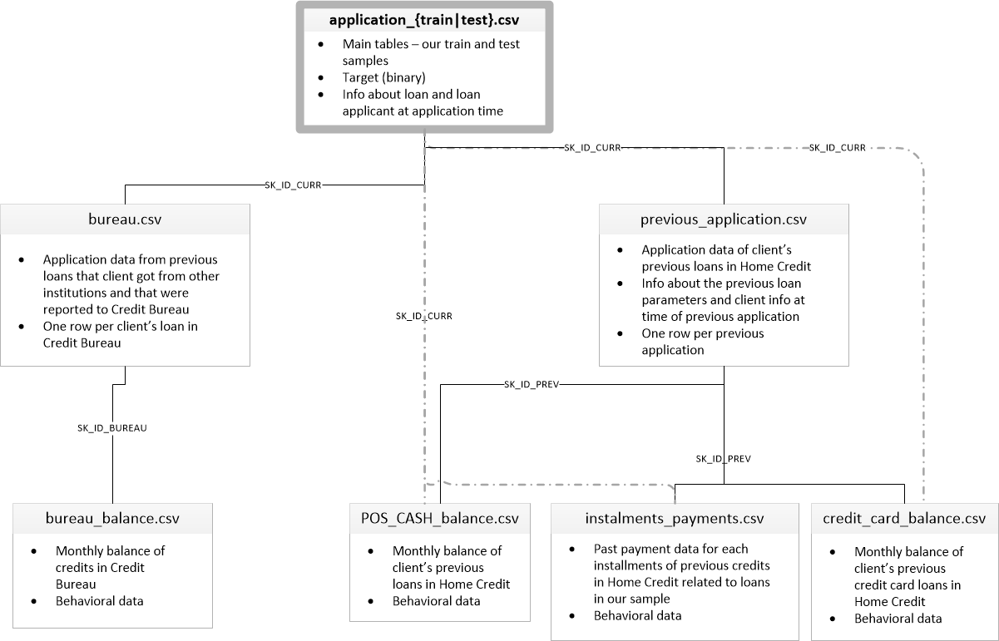


# <a id="2"></a> 2. Préparation des données et feature engineering

Afin de faciliter l’analyse exploratoire, la préparation des données et le feature engineering nécessaires à l’élaboration du modèle de scoring, nous nous basons sur un kernel Kaggle : https://www.kaggle.com/code/jsaguiar/lightgbm-with-simple-features/script

In [14]:
@contextmanager
def timer(title):
    '''Fonction calculant le temps d'éxécution d'autres fonctions.
    Keyword arguments:
    title -- titre de la fonction exécutée.
    '''
    t0 = time.time()
    yield
    print("{} - réalisé en {:.0f}s".format(title, time.time() - t0))

def one_hot_encoder(df, nan_as_category = True):
    '''Encodage des variables catégorielles.
    Keyword arguments:
    df -- dataframe
    nan_as_category -- ajout d'une colonne indiquant les NaN (default True)
    Returns:
    df -- dataframe encodé
    new_columns -- nouvelles colonnes créées par l'encodage.
    '''
    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns= categorical_columns, dummy_na= nan_as_category, dtype=int)
    new_columns = [c for c in df.columns if c not in original_columns]
    
    return df, new_columns

def application_train_test(num_rows = None, nan_as_category = False):
    '''Preprocessing de application_train.csv et application_test.csv.
    Keyword arguments:
    num_rows -- nombre de lignes (default None)
    nan_as_category -- ajout d'une colonne indiquant les NaN (default False)
    Returns:
    df -- dataframe mergé et preprocessing réalisé.
    '''
    # Read data and merge
    df = pd.read_csv('data/application_train.csv', nrows= num_rows)
    test_df = pd.read_csv('data/application_test.csv', nrows= num_rows)
    print("Taille des données d'entrainement: {}, Taille des données de test: {}".format(len(df), len(test_df)))
    df = pd.concat([df,test_df], ignore_index=True)
    # Optional: Remove 4 applications with XNA CODE_GENDER (train set)
    df = df[df['CODE_GENDER'] != 'XNA']
    
    # Categorical features with Binary encode (0 or 1; two categories)
    for bin_feature in ['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']:
        df[bin_feature], uniques = pd.factorize(df[bin_feature])
    # Categorical features with One-Hot encode
    df, cat_cols = one_hot_encoder(df, nan_as_category)
    
    # NaN values for DAYS_EMPLOYED: 365.243 -> nan
    df['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)
    # Some simple new features (percentages)
    df['DAYS_EMPLOYED_PERC'] = df['DAYS_EMPLOYED'] / df['DAYS_BIRTH']
    df['INCOME_CREDIT_PERC'] = df['AMT_INCOME_TOTAL'] / df['AMT_CREDIT']
    df['INCOME_PER_PERSON'] = df['AMT_INCOME_TOTAL'] / df['CNT_FAM_MEMBERS']
    df['ANNUITY_INCOME_PERC'] = df['AMT_ANNUITY'] / df['AMT_INCOME_TOTAL']
    df['PAYMENT_RATE'] = df['AMT_ANNUITY'] / df['AMT_CREDIT']

    del test_df
    gc.collect()
    
    return df

def bureau_and_balance(num_rows = None, nan_as_category = True):
    '''Preprocessing de bureau.csv et bureau_balance.csv.
    Keyword arguments:
    num_rows -- nombre de lignes (default None)
    nan_as_category -- ajout d'une colonne indiquant les NaN (default True)
    Returns:
    bureau_agg -- dataframe aggregé et preprocessing réalisé.
    '''
    bureau = pd.read_csv('data/bureau.csv', nrows = num_rows)
    bb = pd.read_csv('data/bureau_balance.csv', nrows = num_rows)
    bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category)
    
    # Bureau balance: Perform aggregations and merge with bureau.csv
    bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    for col in bb_cat:
        bb_aggregations[col] = ['mean']
    bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    bureau.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    del bb, bb_agg
    gc.collect()
    
    # Bureau and bureau_balance numeric features
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum']
    }
    # Bureau and bureau_balance categorical features
    cat_aggregations = {}
    for cat in bureau_cat: cat_aggregations[cat] = ['mean']
    for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']
    
    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    
    # Bureau: Active credits - using only numerical aggregations
    active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    active_agg = active.groupby('SK_ID_CURR').agg(num_aggregations)
    active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in active_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(active_agg, how='left', on='SK_ID_CURR')
    del active, active_agg
    gc.collect()
    
    # Bureau: Closed credits - using only numerical aggregations
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    closed_agg = closed.groupby('SK_ID_CURR').agg(num_aggregations)
    closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in closed_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(closed_agg, how='left', on='SK_ID_CURR')
    del closed, closed_agg, bureau
    gc.collect()
    
    return bureau_agg

def previous_applications(num_rows = None, nan_as_category = True):
    '''Preprocessing de previous_applications.csv.
    Keyword arguments:
    num_rows -- nombre de lignes (default None)
    nan_as_category -- ajout d'une colonne indiquant les NaN (default True)
    Returns:
    prev_agg -- dataframe aggregé et preprocessing réalisé.
    '''
    prev = pd.read_csv('data/previous_application.csv', nrows = num_rows)
    prev, cat_cols = one_hot_encoder(prev, nan_as_category= True)
    # Days 365.243 values -> nan
    prev['DAYS_FIRST_DRAWING'].replace(365243, np.nan, inplace= True)
    prev['DAYS_FIRST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE_1ST_VERSION'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_TERMINATION'].replace(365243, np.nan, inplace= True)
    # Add feature: value ask / value received percentage
    prev['APP_CREDIT_PERC'] = prev['AMT_APPLICATION'] / prev['AMT_CREDIT']
    
    # Previous applications numeric features
    num_aggregations = {
        'AMT_ANNUITY': ['min', 'max', 'mean'],
        'AMT_APPLICATION': ['min', 'max', 'mean'],
        'AMT_CREDIT': ['min', 'max', 'mean'],
        'APP_CREDIT_PERC': ['min', 'max', 'mean', 'var'],
        'AMT_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'AMT_GOODS_PRICE': ['min', 'max', 'mean'],
        'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
        'RATE_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'DAYS_DECISION': ['min', 'max', 'mean'],
        'CNT_PAYMENT': ['mean', 'sum'],
    }
    # Previous applications categorical features
    cat_aggregations = {}
    for cat in cat_cols:
        cat_aggregations[cat] = ['mean']
    
    prev_agg = prev.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    prev_agg.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() for e in prev_agg.columns.tolist()])
    
    # Previous Applications: Approved Applications - only numerical features
    approved = prev[prev['NAME_CONTRACT_STATUS_Approved'] == 1]
    approved_agg = approved.groupby('SK_ID_CURR').agg(num_aggregations)
    approved_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in approved_agg.columns.tolist()])
    prev_agg = prev_agg.join(approved_agg, how='left', on='SK_ID_CURR')
    
    # Previous Applications: Refused Applications - only numerical features
    refused = prev[prev['NAME_CONTRACT_STATUS_Refused'] == 1]
    refused_agg = refused.groupby('SK_ID_CURR').agg(num_aggregations)
    refused_agg.columns = pd.Index(['REFUSED_' + e[0] + "_" + e[1].upper() for e in refused_agg.columns.tolist()])
    prev_agg = prev_agg.join(refused_agg, how='left', on='SK_ID_CURR')
    del refused, refused_agg, approved, approved_agg, prev
    gc.collect()
    
    return prev_agg

def pos_cash(num_rows = None, nan_as_category = True):
    '''Preprocessing de POS_CASH_balance.csv.
    Keyword arguments:
    num_rows -- nombre de lignes (default None)
    nan_as_category -- ajout d'une colonne indiquant les NaN (default True)
    Returns:
    pos_agg -- dataframe aggregé et preprocessing réalisé.
    '''
    pos = pd.read_csv('data/POS_CASH_balance.csv', nrows = num_rows)
    pos, cat_cols = one_hot_encoder(pos, nan_as_category= True)
    
    # Features
    aggregations = {
        'MONTHS_BALANCE': ['max', 'mean', 'size'],
        'SK_DPD': ['max', 'mean'],
        'SK_DPD_DEF': ['max', 'mean']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    
    pos_agg = pos.groupby('SK_ID_CURR').agg(aggregations)
    pos_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in pos_agg.columns.tolist()])
    # Count pos cash accounts
    pos_agg['POS_COUNT'] = pos.groupby('SK_ID_CURR').size()
    del pos
    gc.collect()
    
    return pos_agg
    
def installments_payments(num_rows = None, nan_as_category = True):
    '''Preprocessing de installments_payments.csv.
    Keyword arguments:
    num_rows -- nombre de lignes (default None)
    nan_as_category -- ajout d'une colonne indiquant les NaN (default True)
    Returns:
    ins_agg -- dataframe aggregé et preprocessing réalisé.
    '''
    ins = pd.read_csv('data/installments_payments.csv', nrows = num_rows)
    ins, cat_cols = one_hot_encoder(ins, nan_as_category= True)
    
    # Percentage and difference paid in each installment (amount paid and installment value)
    ins['PAYMENT_PERC'] = ins['AMT_PAYMENT'] / ins['AMT_INSTALMENT']
    ins['PAYMENT_DIFF'] = ins['AMT_INSTALMENT'] - ins['AMT_PAYMENT']
    # Days past due and days before due (no negative values)
    ins['DPD'] = ins['DAYS_ENTRY_PAYMENT'] - ins['DAYS_INSTALMENT']
    ins['DBD'] = ins['DAYS_INSTALMENT'] - ins['DAYS_ENTRY_PAYMENT']
    ins['DPD'] = ins['DPD'].apply(lambda x: x if x > 0 else 0)
    ins['DBD'] = ins['DBD'].apply(lambda x: x if x > 0 else 0)
    
    # Features: Perform aggregations
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['nunique'],
        'DPD': ['max', 'mean', 'sum'],
        'DBD': ['max', 'mean', 'sum'],
        'PAYMENT_PERC': ['max', 'mean', 'sum', 'var'],
        'PAYMENT_DIFF': ['max', 'mean', 'sum', 'var'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum'],
        'AMT_PAYMENT': ['min', 'max', 'mean', 'sum'],
        'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    # Count installments accounts
    ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    del ins
    gc.collect()
    
    return ins_agg

def credit_card_balance(num_rows = None, nan_as_category = True):
    '''Preprocessing de credit_card_balance.csv.
    Keyword arguments:
    num_rows -- nombre de lignes (default None)
    nan_as_category -- ajout d'une colonne indiquant les NaN (default True)
    Returns:
    cc_agg -- dataframe aggregé et preprocessing réalisé.
    '''
    cc = pd.read_csv('data/credit_card_balance.csv', nrows = num_rows)
    cc, cat_cols = one_hot_encoder(cc, nan_as_category= True)
    
    # General aggregations
    cc.drop(['SK_ID_PREV'], axis= 1, inplace = True)
    cc_agg = cc.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
    # Count credit card lines
    cc_agg['CC_COUNT'] = cc.groupby('SK_ID_CURR').size()
    del cc
    gc.collect()
    
    return cc_agg

In [15]:
num_rows = None
df = application_train_test(num_rows)

with timer("Process bureau and bureau_balance"):
    bureau = bureau_and_balance(num_rows)
    print("Bureau df shape:", bureau.shape)
    df = df.join(bureau, how='left', on='SK_ID_CURR')
    del bureau
    gc.collect()
with timer("Process previous_applications"):
    prev = previous_applications(num_rows)
    print("Previous applications df shape:", prev.shape)
    df = df.join(prev, how='left', on='SK_ID_CURR')
    del prev
    gc.collect()
with timer("Process POS-CASH balance"):
    pos = pos_cash(num_rows)
    print("Pos-cash balance df shape:", pos.shape)
    df = df.join(pos, how='left', on='SK_ID_CURR')
    del pos
    gc.collect()
with timer("Process installments payments"):
    ins = installments_payments(num_rows)
    print("Installments payments df shape:", ins.shape)
    df = df.join(ins, how='left', on='SK_ID_CURR')
    del ins
    gc.collect()
with timer("Process credit card balance"):
    cc = credit_card_balance(num_rows)
    print("Credit card balance df shape:", cc.shape)
    df = df.join(cc, how='left', on='SK_ID_CURR')
    del cc
    gc.collect()

Taille des données d'entrainement: 307511, Taille des données de test: 48744


C:\Users\ozenzamy\AppData\Local\Temp\ipykernel_7776\2612044330.py:50: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





Bureau df shape: (305811, 116)
Process bureau and bureau_balance - réalisé en 27s


C:\Users\ozenzamy\AppData\Local\Temp\ipykernel_7776\2612044330.py:141: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



C:\Users\ozenzamy\AppData\Local\Temp\ipykernel_7776\2612044330.py:142: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, 

Previous applications df shape: (338857, 249)
Process previous_applications - réalisé en 40s
Pos-cash balance df shape: (337252, 18)
Process POS-CASH balance - réalisé en 18s
Installments payments df shape: (339587, 26)
Process installments payments - réalisé en 30s
Credit card balance df shape: (103558, 141)
Process credit card balance - réalisé en 22s


In [16]:
train_df = df[df['TARGET'].notnull()]
test_df = df[df['TARGET'].isnull()]
print("Taille des données d'entrainement: {}".format(len(train_df)))
print("Taille des données de test: {}".format(len(test_df)))

Taille des données d'entrainement: 307507
Taille des données de test: 48744


In [17]:
train_df.to_csv('train_df.csv', index = False)
test_df.to_csv('test_df.csv', index = False)

In [18]:
print("Taille du jeu d'entrainement: {}".format(train_df.shape))
print("Taille du jeu de test: {}".format(test_df.shape))

Taille du jeu d'entrainement: (307507, 797)
Taille du jeu de test: (48744, 797)


In [19]:
print("Nombre de lignes dupliquées dans le jeu d'entrainement: {}".format(fc.data_duplicated(train_df)))
print("Nombre de lignes dupliquées dans le jeu de test: {}".format(fc.data_duplicated(test_df)))

Nombre de lignes dupliquées dans le jeu d'entrainement: 0
Nombre de lignes dupliquées dans le jeu de test: 0


Il n'y a pas de doublons dans notre jeu de données. 

Voyons désormais les données manquantes.

In [12]:
print('Le dataset train :')
fc.missing_general(train_df)
print()
print('Le dataset test :')
fc.missing_general(test_df)

Le dataset train :
Nombre total de cellules manquantes : 63543491
Nombre de cellules manquantes en % : 25.93%

Le dataset test :
Nombre total de cellules manquantes : 8556450
Nombre de cellules manquantes en % : 22.02%


Nos deux dataset contiennent des données manquantes, voyons cela plus en détail.

In [13]:
fc.bar_missing(train_df)

In [14]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307507 entries, 0 to 307510
Columns: 797 entries, SK_ID_CURR to CC_COUNT
dtypes: float64(622), int32(133), int64(42)
memory usage: 1.7 GB


Nous avons 797 variables. On commence par supprimer celles ayant plus de 50% de valeurs manquantes.

In [20]:
train_df = fc.drop_columns_empty(train_df,0.5)

Suppression de la variable OWN_CAR_AGE avec % de valeurs manquantes 0.66
Suppression de la variable EXT_SOURCE_1 avec % de valeurs manquantes 0.56
Suppression de la variable APARTMENTS_AVG avec % de valeurs manquantes 0.51
Suppression de la variable BASEMENTAREA_AVG avec % de valeurs manquantes 0.59
Suppression de la variable YEARS_BUILD_AVG avec % de valeurs manquantes 0.66
Suppression de la variable COMMONAREA_AVG avec % de valeurs manquantes 0.7
Suppression de la variable ELEVATORS_AVG avec % de valeurs manquantes 0.53
Suppression de la variable ENTRANCES_AVG avec % de valeurs manquantes 0.5
Suppression de la variable FLOORSMIN_AVG avec % de valeurs manquantes 0.68
Suppression de la variable LANDAREA_AVG avec % de valeurs manquantes 0.59
Suppression de la variable LIVINGAPARTMENTS_AVG avec % de valeurs manquantes 0.68
Suppression de la variable LIVINGAREA_AVG avec % de valeurs manquantes 0.5
Suppression de la variable NONLIVINGAPARTMENTS_AVG avec % de valeurs manquantes 0.69
Suppres

In [16]:
train_df.shape

(307507, 561)

In [21]:
test_df = test_df[train_df.columns]
print(test_df.shape)

(48744, 561)


Il nous reste désormais 561 variables.

Voyons plus en détail certaines d'entre elles. La variable *'DAYS_BIRTH'* est négative car ce sont les jours enregistrés par rapport à la demande de prêt en cours. Nous allons donc transformer cette variable en nombre positifs représentant des années.

In [18]:
train_df['DAYS_BIRTH'].describe()

count    307507.000000
mean     -16037.027271
std        4363.982424
min      -25229.000000
25%      -19682.000000
50%      -15750.000000
75%      -12413.000000
max       -7489.000000
Name: DAYS_BIRTH, dtype: float64

In [19]:
(train_df['DAYS_BIRTH']/-365).describe()

count    307507.000000
mean         43.937061
std          11.956116
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: DAYS_BIRTH, dtype: float64

In [22]:
train_df['DAYS_BIRTH'] = train_df['DAYS_BIRTH']/-365
test_df['DAYS_BIRTH'] = test_df['DAYS_BIRTH']/-365

In [23]:
# change les valeurs négatives en valeurs positives.
train_df[train_df.columns[(train_df < 0).any()].tolist()] = train_df[
    train_df.columns[(train_df < 0).any()].tolist()]*-1

test_df[test_df.columns[(test_df < 0).any()].tolist()] = test_df[
    test_df.columns[(test_df < 0).any()].tolist()]*-1

In [24]:
train_df['DAYS_ID_PUBLISH'] = train_df['DAYS_ID_PUBLISH'].astype(float)
test_df['DAYS_ID_PUBLISH'] = test_df['DAYS_ID_PUBLISH'].astype(float)

In [23]:
train_df['DAYS_EMPLOYED'].describe()

count    252133.000000
mean       2384.142254
std        2338.327666
min          -0.000000
25%         767.000000
50%        1648.000000
75%        3175.000000
max       17912.000000
Name: DAYS_EMPLOYED, dtype: float64

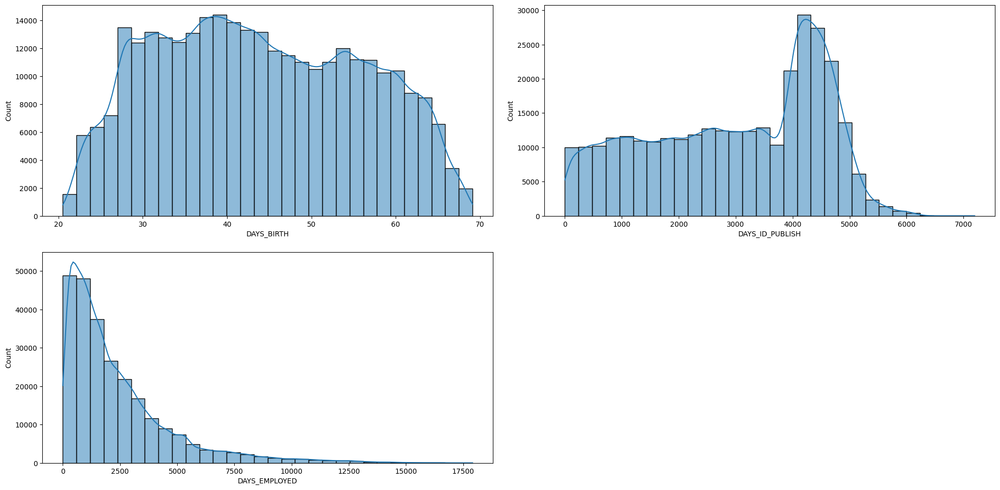

In [24]:
fc.distribution(train_df,['DAYS_BIRTH','DAYS_ID_PUBLISH','DAYS_EMPLOYED'],
                n_cols=2, nom='histo_3.pdf', fig=(20,10))

Transformons notre variable *'TARGET'* en entier et supprimons cette variable de notre test set.

In [25]:
train_df['TARGET'] = train_df['TARGET'].astype(int)

In [26]:
test_df = test_df.drop('TARGET',axis=1)

Remplacons désormais les valeurs infinies par NaN avant de procéder à une imputation.

In [27]:
train_df = train_df.replace(np.inf, np.nan)
test_df = test_df.replace(np.inf, np.nan)

In [28]:
train_df.to_csv('train_df_nan.csv', index = False)
test_df.to_csv('test_df_nan.csv', index = False)

**Imputations:**

Imputons désormais nos données. 
Nous allons appliquer différentes méthodes d'imputation simples. Tout d'abord, pour les colonnes qui proviennent de l'aggrégation, nous allons remplacer les valeurs manquantes par *0.0*. Pour les variables quantitatives restantes, nous remplacerons par la médiane. Enfin, pour les variables qualitatives/catégorielles, nous remplacerons par le mode (soit la valeur la plus fréquente).

In [28]:
quanti_col = train_df.select_dtypes(['float64']).columns
quali_col = train_df.select_dtypes(['int64']).columns
# quali_col = quali_col.drop('TARGET')

In [29]:
# imputation des variables quantitatives issues de l'aggrégation
col_agg = train_df.columns[train_df.columns.str.contains('_MIN|_MAX|_MEAN|_VAR|_SUM|_SIZE')]

train_df[col_agg] = train_df[col_agg].fillna(0.0)
test_df[col_agg] = test_df[col_agg].fillna(0.0)

In [30]:
# imputation des variables quantitatives restantes
quanti_col_rest = [col for col in quanti_col if col not in col_agg]
for col in quanti_col_rest:
    median = train_df[col].median()
    train_df[col] = train_df[col].fillna(median)
    test_df[col] = test_df[col].fillna(median)

In [31]:
# imputation des variables qualitatives
for col in quali_col:
    mode = train_df[col].mode()[0]
    train_df[col] = train_df[col].fillna(mode)
    test_df[col] = test_df[col].fillna(mode)

In [34]:
print('Le dataset train :')
fc.missing_general(train_df)
print()
print('Le dataset test :')
fc.missing_general(test_df)

Le dataset train :
Nombre total de cellules manquantes : 0
Nombre de cellules manquantes en % : 0.00%

Le dataset test :
Nombre total de cellules manquantes : 0
Nombre de cellules manquantes en % : 0.00%


In [ ]:
train_df.to_csv('train_df_cleaned.csv', index = False)
test_df.to_csv('test_df_cleaned.csv', index = False)

# <a id="3"></a> 3. Exploration des données

In [35]:
train_df.describe()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_2,EXT_SOURCE_3,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,YEARS_BEGINEXPLUATATION_MODE,FLOORSMAX_MODE,YEARS_BEGINEXPLUATATION_MEDI,FLOORSMAX_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,...,PREV_NAME_SELLER_INDUSTRY_XNA_MEAN,PREV_NAME_SELLER_INDUSTRY_nan_MEAN,PREV_NAME_YIELD_GROUP_XNA_MEAN,PREV_NAME_YIELD_GROUP_high_MEAN,PREV_NAME_YIELD_GROUP_low_action_MEAN,PREV_NAME_YIELD_GROUP_low_normal_MEAN,PREV_NAME_YIELD_GROUP_middle_MEAN,PREV_NAME_YIELD_GROUP_nan_MEAN,PREV_PRODUCT_COMBINATION_Card Street_MEAN,PREV_PRODUCT_COMBINATION_Card X-Sell_MEAN,PREV_PRODUCT_COMBINATION_Cash_MEAN,PREV_PRODUCT_COMBINATION_Cash Street: high_MEAN,PREV_PRODUCT_COMBINATION_Cash Street: low_MEAN,PREV_PRODUCT_COMBINATION_Cash Street: middle_MEAN,PREV_PRODUCT_COMBINATION_Cash X-Sell: high_MEAN,PREV_PRODUCT_COMBINATION_Cash X-Sell: low_MEAN,PREV_PRODUCT_COMBINATION_Cash X-Sell: middle_MEAN,PREV_PRODUCT_COMBINATION_POS household with interest_MEAN,PREV_PRODUCT_COMBINATION_POS household without interest_MEAN,PREV_PRODUCT_COMBINATION_POS industry with interest_MEAN,PREV_PRODUCT_COMBINATION_POS industry without interest_MEAN,PREV_PRODUCT_COMBINATION_POS mobile with interest_MEAN,PREV_PRODUCT_COMBINATION_POS mobile without interest_MEAN,PREV_PRODUCT_COMBINATION_POS other with interest_MEAN,PREV_PRODUCT_COMBINATION_POS others without interest_MEAN,PREV_PRODUCT_COMBINATION_nan_MEAN,APPROVED_AMT_ANNUITY_MIN,APPROVED_AMT_ANNUITY_MAX,APPROVED_AMT_ANNUITY_MEAN,APPROVED_AMT_APPLICATION_MIN,APPROVED_AMT_APPLICATION_MAX,APPROVED_AMT_APPLICATION_MEAN,APPROVED_AMT_CREDIT_MIN,APPROVED_AMT_CREDIT_MAX,APPROVED_AMT_CREDIT_MEAN,APPROVED_APP_CREDIT_PERC_MIN,APPROVED_APP_CREDIT_PERC_MAX,APPROVED_APP_CREDIT_PERC_MEAN,APPROVED_APP_CREDIT_PERC_VAR,APPROVED_AMT_DOWN_PAYMENT_MIN,APPROVED_AMT_DOWN_PAYMENT_MAX,APPROVED_AMT_DOWN_PAYMENT_MEAN,APPROVED_AMT_GOODS_PRICE_MIN,APPROVED_AMT_GOODS_PRICE_MAX,APPROVED_AMT_GOODS_PRICE_MEAN,APPROVED_HOUR_APPR_PROCESS_START_MIN,APPROVED_HOUR_APPR_P

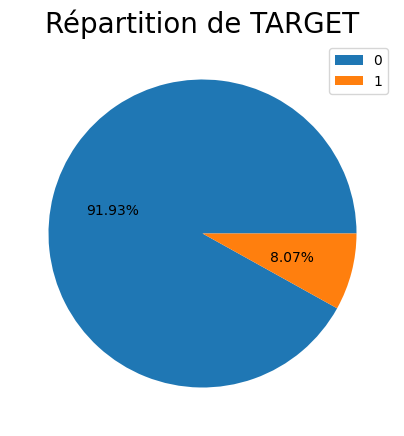

In [36]:
fc.pie_plot(train_df,['TARGET'])

Pour notre target, 1 correspond aux clients en difficulté de paiement (il a eu un retard de paiement de plus de X jours sur au moins une des Y premières échéances du crédit de notre échantillon), 0 correspond aux autres clients (qui n'ont donc pas de difficultés de paiement).

On constate que notre target est déséquilibrée. En effet, notre dataframe comporte beaucoup plus de clients ne possédant pas de difficultés de paiement (91.93%).

Nous verrons par la suite comment nous pouvons rééquilibrer notre target en vue d'une modélisation.

In [37]:
train_df_init = pd.read_csv('data/application_train.csv')

In [38]:
col_cat = list(train_df_init.select_dtypes(['object']).columns)
col_cat.append('TARGET')
fc.bar_plot_stacked(train_df_init, col_cat, n_cols=2, nom='bar_plot2.pdf', fig=(40,140))

On constate des modalités majoritaires pour la plupart des variables. 

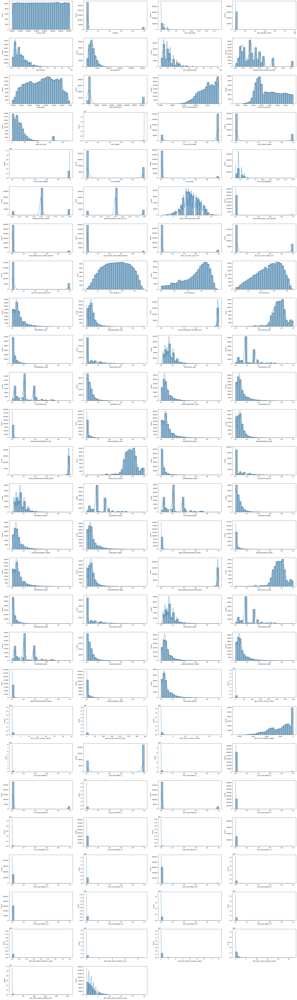

In [39]:
fc.distribution(train_df_init, train_df_init.select_dtypes(exclude=['object']).columns,
                n_cols=4, nom='distribution.pdf',fig=(30,100))




Nous allons désormais étudier les densités de certaines variables via un graphique KDE.
Un graphique d'estimation de la densité du noyau (KDE) est une méthode de visualisation de la distribution des observations dans un ensemble de données, analogue à un histogramme. KDE représente les données à l'aide d'une courbe de densité de probabilité continue dans une ou plusieurs dimensions.
Par rapport à un histogramme, KDE peut produire un tracé moins encombré et plus interprétable, en particulier lors du dessin de plusieurs distributions.

Text(0.5, 1.0, 'Distribution of Ages')

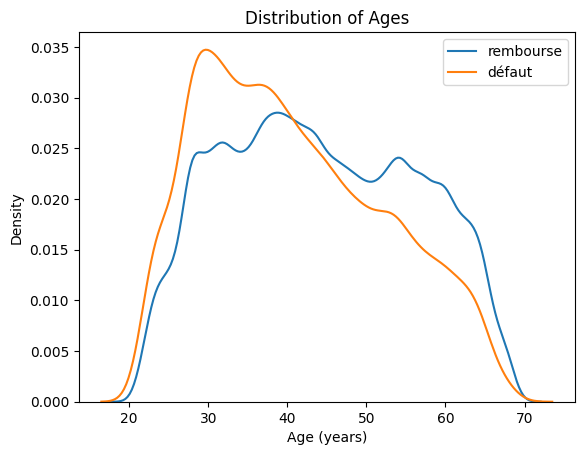

In [40]:
sns.kdeplot(train_df.loc[train_df['TARGET'] == 0, 'DAYS_BIRTH'], label = 'rembourse')
sns.kdeplot(train_df.loc[train_df['TARGET'] == 1, 'DAYS_BIRTH'], label = 'défaut')

plt.xlabel('Age (years)')
plt.ylabel('Density')
plt.legend()
plt.title('Distribution of Ages')

On peut constater ici que la courbe représentant les clients en défaut tend vers des âges plus jeunes, par rapport à la courbe représentant les clients qui remboursent. Cela pourrait signifier que les clients en défaut ont plus tendance à être jeunes.

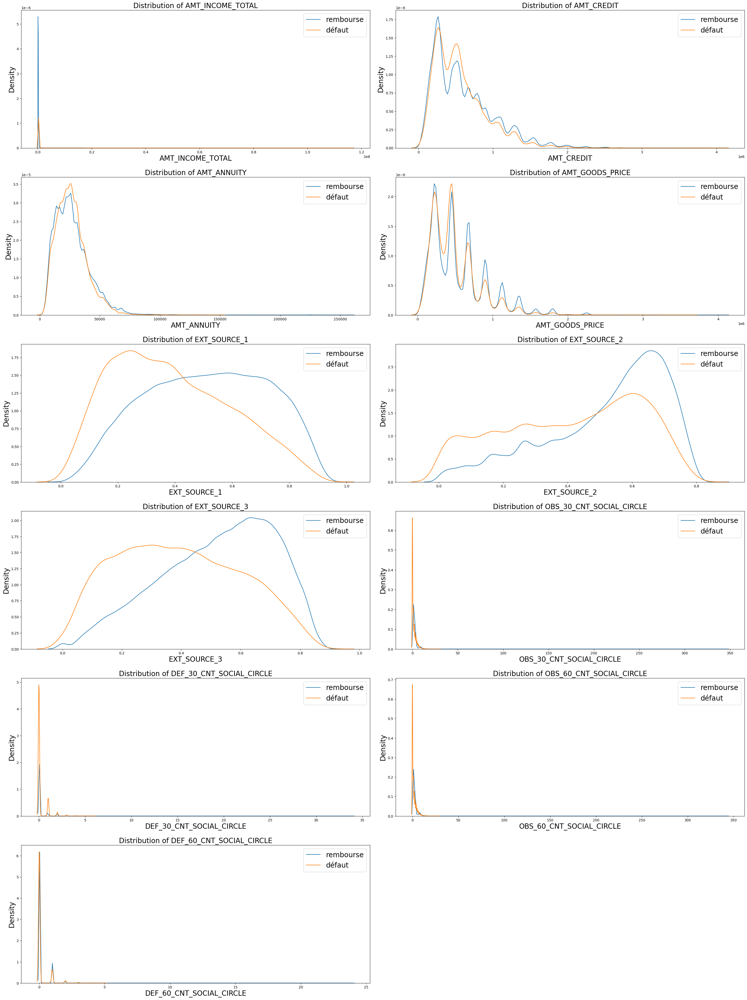

In [41]:
col_density = ['AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE',
               'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3','OBS_30_CNT_SOCIAL_CIRCLE',
               'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE','DEF_60_CNT_SOCIAL_CIRCLE']
fc.distribution_densite(train_df_init,col_density,n_cols=2,nom='densite.pdf',fig=(30,40))

On ne constate pas de grande différences entre les deux classes (*rembourse* ou *défaut*) pour la plupart des variables exceptées *'EXT_SOURCE_1'*, *'EXT_SOURCE_2'* et *'EXT_SOURCE_3'*. En effet, on peut constater que la classe représentant les clients en défaut semble être plus présente lorsque les valeurs pour ces variabels sont faibles, et inversement pour la seconde classe.

In [42]:
col_quant = list(train_df_init.select_dtypes(['float64']).columns)
col_quant.append('TARGET')

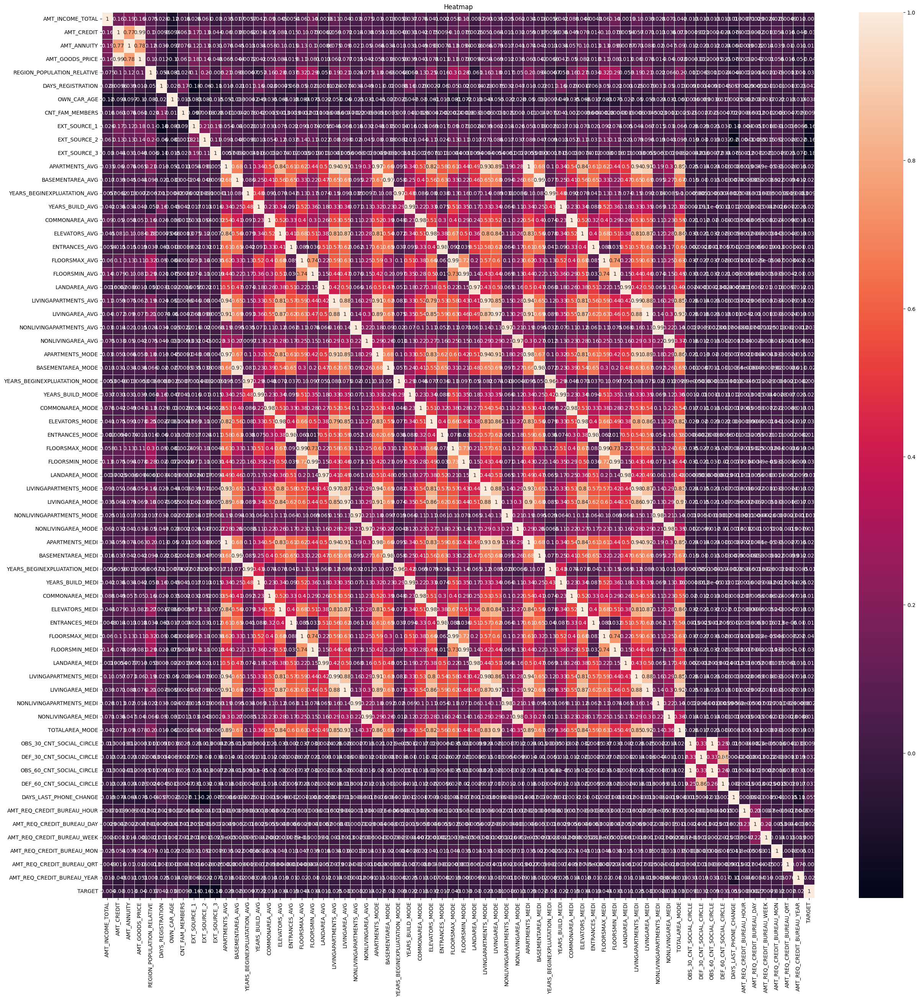

In [43]:
df_corr = train_df_init[col_quant].corr()

fc.heat_map(df_corr)

# <a id="4"></a> 4. Modélisation

Dans un premier temps, nous réalisons une séparation des données en jeu d'entraînement et jeu de validation.

In [32]:
# Nous devons retirer les caractères spéciaux des noms des features pour l'utilisation de certains modèles (LightGBM)
import re
y = train_df['TARGET']
X = train_df.drop('TARGET', axis=1)
X = X.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
test_df = test_df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [33]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.20, stratify=y, random_state=0)

print(X_train.shape, y_train.shape)
print(X_val.shape, y_val.shape)

(246005, 560) (246005,)
(61502, 560) (61502,)


In [46]:
pickle.dump(X_train, open('models/X_train.pkl', 'wb'))
pickle.dump(y_train, open('models/y_train.pkl', 'wb'))
pickle.dump(X_val, open('models/X_val.pkl', 'wb'))
pickle.dump(y_val, open('models/y_val.pkl', 'wb'))

In [34]:
X_val, X_val_test, y_val, y_val_test = train_test_split(X_val, y_val, test_size=0.20, stratify=y_val, random_state=0)

print(X_val_test.shape, y_val_test.shape)
print(X_val.shape, y_val.shape)

(12301, 560) (12301,)
(49201, 560) (49201,)


In [48]:
pickle.dump(X_val, open('models/X_val.pkl', 'wb'))
pickle.dump(X_val_test, open('models/X_val_test.pkl', 'wb'))
pickle.dump(y_val, open('models/y_val.pkl', 'wb'))
pickle.dump(y_val_test, open('models/y_val_test.pkl', 'wb'))

In [35]:
cols = X_train.select_dtypes(['float64']).columns

X_train_scaled = X_train.copy()
X_val_scaled = X_val.copy()
X_val_test_scaled = X_val_test.copy()
X_test_scaled = test_df.copy()

std_scale = StandardScaler()
std_scale.fit(X_train[cols])

X_train_scaled[cols] = std_scale.transform(X_train[cols])
X_val_scaled[cols] = std_scale.transform(X_val[cols])
X_val_test_scaled[cols] = std_scale.transform(X_val_test[cols])
X_test_scaled[cols] = std_scale.transform(test_df[cols])

In [50]:
pickle.dump(X_train_scaled, open('models/X_train_scaled.pkl', 'wb'))
pickle.dump(X_val_scaled, open('models/X_val_scaled.pkl', 'wb'))
pickle.dump(X_val_test_scaled, open('models/X_val_test_scaled.pkl', 'wb'))
pickle.dump(X_test_scaled, open('models/X_test_scaled.pkl', 'wb'))

In [36]:
X_train_scaled = pickle.load(open('models/X_train_scaled.pkl', 'rb'))
y_train = pickle.load(open('models/y_train.pkl', 'rb'))
X_val = pickle.load(open('models/X_val.pkl', 'rb'))
X_val_scaled = pickle.load(open('models/X_val_scaled.pkl', 'rb'))
y_val = pickle.load(open('models/y_val.pkl', 'rb'))
X_val_test = pickle.load(open('models/X_val_test.pkl', 'rb'))
X_val_test_scaled = pickle.load(open('models/X_val_test_scaled.pkl', 'rb'))
y_val_test = pickle.load(open('models/y_val_test.pkl', 'rb'))

Nous créons les fonctions que nous utiliserons dans la suite de la modélisation. Ces fonctions permettent notamment de calculer certaines métriques et graphes à des fins de comparaison des performances de nos modèles.

Nous crééons une métrique personnalisée ayant une approche métier. Le but ici est de pénaliser plus fortement les faux négatifs (mauvais client prédit bon client) qui engendrent une grande perte de capital. On suppose ici que le coût d’un FN (Faux Négatif) est dix fois supérieur au coût d’un FP (Faux Positif).

Nous calculerons également d'autres métriques telles que :
- **Accuracy** : somme de tous les vrais positifs et vrais négatifs qu'il divise par le nombre total d'instances. Il permet d'apporter une réponse à la question suivante : de toutes les classes positives et négatives, combien parmi elles ont été prédites correctement ? Des valeurs élevées de ce paramètre sont souvent souhaitables.
- **Precision** :  indique le rapport entre les prévisions positives correctes et le nombre total de prévisions positives. Ce paramètre répond donc à la question suivante : sur tous les enregistrements positifs prédits, combien sont réellement positifs ? 
- **Recall/Rappel** : paramètre qui permet de mesurer le nombre de prévisions positives correctes sur le nombre total de données positives. Il permet de répondre à la question suivante : sur tous les enregistrements positifs, combien ont été correctement prédits ? La mesure vise à minimiser les faux négatifs.
- **F1 score** : moyenne harmonique de la précision et du rappel. Il équivaut au double du produit de ces deux paramètres sur leur somme. Sa valeur est maximale lorsque le rappel et la précision sont équivalents. Il est particulièrement difficile de comparer deux modèles avec une faible précision et un rappel élevé. Le contraire est également vérifié. Dans ces conditions, le score F1 permet de mesurer ces deux paramètres simultanément.
- **Fbeta score** : généralisation de la F-measure qui ajoute un paramètre de configuration appelé beta. Une valeur bêta par défaut est 1.0, ce qui est identique à la mesure F. Une valeur bêta plus petite, telle que 0.5, donne plus de poids à la précision et moins au rappel, tandis qu'une valeur bêta plus grande, telle que 2.0, donne moins de poids à la précision et plus de poids au rappel dans le calcul du score. Ici nous donnons plus de poids au rappel qui minimise les faux négatifs.
- **ROC AUC score** : mesure de façon globale la performance d’un modèle de classification. Il indique à quel point le modèle est capable de faire la distinction entre les classes. Il est égal à 1 pour un modèle parfait et à 0.5 pour un modèle non-informatif. 

In [37]:
def fonction_metier(y_true, y_pred):
    '''Créer un score métier à partir de la matrice de confusion.
    :param: y_true (vraies valeurs), y_pred (valeurs prédites par le modèle)
    :return: gain (score métier)
    '''
    TP_coeff = 0       # Vrais positifs
    FP_coeff = 0       # Faux positifs (prédit comme faisant défaut (1) mais ne fait pas défaut (0))
    FN_coeff = -10     # Faux négatifs (prédit comme ne faisant pas défaut (0) mais font défaut (1))
    TN_coeff = 1       # Vrais négatifs
    
    # Assurer que y_true et y_pred sont de type int
    y_true = y_true.astype(int)
    y_pred = y_pred.astype(int)
    
    (TN, FP, FN, TP) = metrics.confusion_matrix(y_true, y_pred).ravel()
    
    gain = (TP*TP_coeff + TN*TN_coeff + FP*FP_coeff + FN*FN_coeff)/(TN+FP+FN+TP)
    
    return gain


def score_metier_max(y_pred_proba, y_true, verbose=True):
    '''Créer un graphique permettant de déterminer quel peut être le score max en fonction du threshold.
    :param: y_pred_proba (probabilités prédites par le modèle), y_true (vraies valeurs),
    verbose (affiche le graphe ou juste le score maximal)
    :return: graphique, 
    '''
    scores = []
    # Assurer que y_true est de type int
    y_true = y_true.astype(int)
    
    for threshold in np.linspace(0, 1, num=101):
        y_pred = np.where(y_pred_proba > threshold, 1, 0).astype(int)
        score = fonction_metier(y_true, y_pred)
        scores.append(score)

    if verbose:
        score_max = max(scores)
        opti_threshold = np.linspace(0, 1, num=101)[scores.index(score_max)]
        y_pred = np.where(y_pred_proba > opti_threshold, 1, 0).astype(int)
        
        print("Score métier maximum : {:.2f}".format(score_max))
        print("Threshold optimal : {}".format(opti_threshold))
        
        fig, ax = plt.subplots(figsize=(6, 5))
        plt.plot(np.linspace(0, 1, num=101), scores, label="model score")
        plt.axvline(x=opti_threshold, color='k', dashes=(0.5, 1), 
                    label="optimal threshold: {}".format(opti_threshold))
        
        plt.title("Score métier en fonction du threshold", fontsize=10)
        plt.xlabel("Thresholds", fontsize=10)
        plt.ylabel("Score métier", fontsize=10)
        plt.legend()
        plt.show()
     
    else:
        return max(scores)


    
def conf_mat_transform(y_true, y_pred):
    '''Créer et affiche la matrice de confusion.
    :param: y_true (vraies valeurs), y_pred (valeurs prédites par le modèle)
    :return: affiche la matrice de confusion
    '''
    conf_mat = metrics.confusion_matrix(y_true,y_pred)
    
    plt.figure(figsize = (6,4))
    sns.heatmap(conf_mat, annot=True, cmap="Blues")
    
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title('Matrice de confusion')


# fonction eval_score
def eval_score(model, X_val, y_true, seuil=0.5):
    y_pred_proba = model.predict_proba(X_val)[:, 1]
    y_pred = np.where(y_pred_proba > seuil, 1, 0).astype(int)
    y_true = y_true.copy().astype(int)  # Créer une copie de y_true pour s'assurer qu'il est modifiable
    
    metier = fonction_metier(y_true, y_pred)
    accuracy = metrics.accuracy_score(y_true, y_pred)
    precision = metrics.precision_score(y_true, y_pred)
    recall = metrics.recall_score(y_true, y_pred)
    f1_score = metrics.f1_score(y_true, y_pred)
    fbeta_score = metrics.fbeta_score(y_true, y_pred, beta=2)
    rocauc = metrics.roc_auc_score(y_true, y_pred_proba)
    
    print('Score métier :{:.2f}'.format(metier))
    print('Accuracy score : {:.2f}'.format(accuracy))
    print('Precision score : {:.2f}'.format(precision))
    print('Recall score : {:.2f}'.format(recall))
    print('F1 score : {:.2f}'.format(f1_score))
    print('Fbeta score : {:.2f}'.format(fbeta_score))
    print('ROC AUC score : {:.2f}'.format(rocauc))
    
    conf_mat_transform(y_true, y_pred)
    
    fig, ax = plt.subplots(figsize=(6, 5))
    
    fpr, tpr, threshold = metrics.roc_curve(y_true, y_pred_proba)
    roc_auc = metrics.auc(fpr, tpr)

    plt.title('Courbe ROC')
    plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
    plt.legend(loc = 'lower right')
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
    
    return metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba

## <a id="5"></a> 4.1 Equilibrage des classes

Nous allons tester différentes méthodes afin de rééquilibrer nos classes qui sont composées à 91.93% de la target 0 contre 8.07% pour la target 1.

Nous testerons ces différentes méthodes avec l'algorithme *LogisticRegression*. 

In [38]:
mlflow.autolog(log_input_examples=True, silent=True)

### 4.1.1 Aucun rééquilibrage

C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Score métier :0.12
Accuracy score : 0.92
Precision score : 0.52
Recall score : 0.02
F1 score : 0.03
Fbeta score : 0.02
ROC AUC score : 0.51


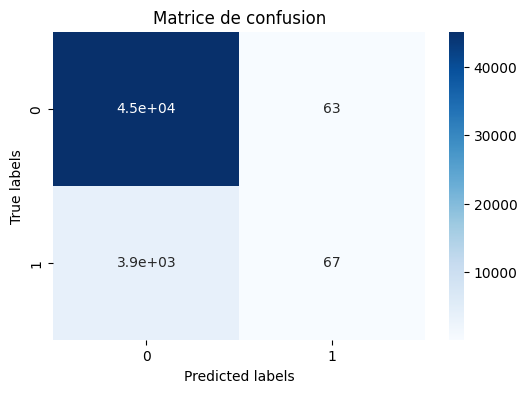

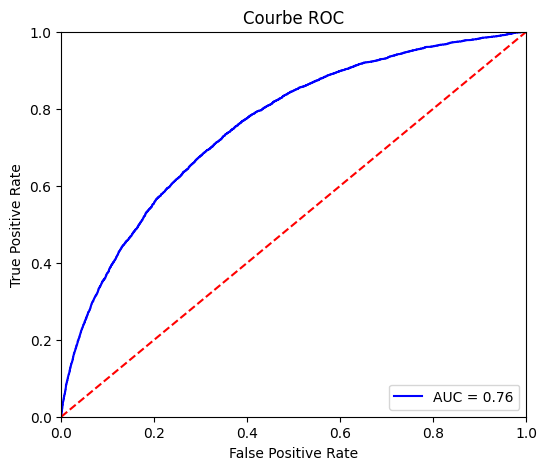

2025/01/06 16:36:31 INFO mlflow.tracking._tracking_service.client: 🏃 View run LogisticRegression sans équilibrage at: http://127.0.0.1:5000/#/experiments/0/runs/b8a190d95e4b4567ab09c8b1517b3888.
2025/01/06 16:36:31 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [55]:
import numpy as np

# Convertir explicitement les données en arrays numpy
X_train_scaled_np = np.array(X_train_scaled, copy=True)
y_train_np = np.array(y_train, copy=True)
X_val_scaled_np = np.array(X_val_scaled, copy=True)
y_val_np = np.array(y_val, copy=True)

with mlflow.start_run(run_name='LogisticRegression sans équilibrage'):
    reg_log_inequal = LogisticRegression(max_iter=1000, random_state=0)
    reg_log_inequal.fit(X_train_scaled_np, y_train_np)

    # Calcul et enregistrement des métriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(reg_log_inequal, X_val_scaled_np, y_val_np)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)


### 4.1.2 Rééquilibrage avec class_weight

La méthode des *class weight* permet de prendre en compte le caractère biaisé de la distribution du dataset et de créer un modèle pénalisé. Il s’agit ici de simplement attribuer des poids différents aux différentes classes de notre dataset, en donnant un poids plus important aux classes minoritaires, afin d’influencer le modèle lors de son entraînement. Nous pénalisons ainsi plus fortement une erreur de classification d’une classe minoritaire par rapport à une erreur de classification d’une classe majoritaire.

C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Score métier :0.39
Accuracy score : 0.70
Precision score : 0.17
Recall score : 0.69
F1 score : 0.27
Fbeta score : 0.43
ROC AUC score : 0.69


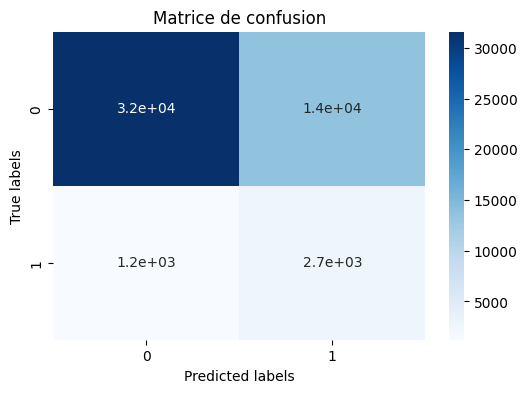

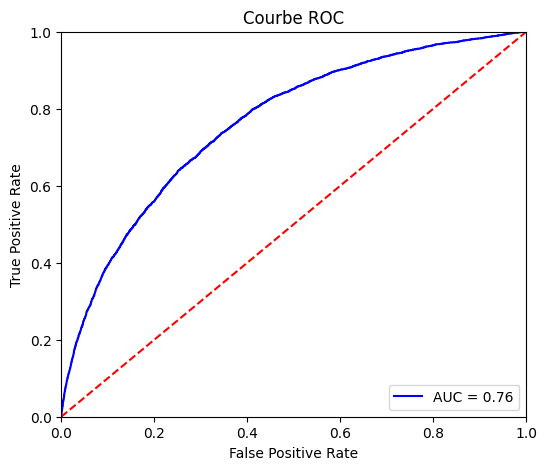

2025/01/06 16:47:33 INFO mlflow.tracking._tracking_service.client: 🏃 View run LogisticRegression class_weight at: http://127.0.0.1:5000/#/experiments/0/runs/ca700998f02f4239a54f403465e05ffe.
2025/01/06 16:47:33 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [57]:
# Rééquilibrage avec class_weight

import numpy as np

# Convertir explicitement les données en arrays numpy
X_train_scaled_np = np.array(X_train_scaled, copy=True)
y_train_np = np.array(y_train, copy=True)
X_val_scaled_np = np.array(X_val_scaled, copy=True)
y_val_np = np.array(y_val, copy=True)

with mlflow.start_run(run_name='LogisticRegression class_weight'):
    reg_log_balanced = LogisticRegression(max_iter=1000, class_weight='balanced', random_state=0)
    reg_log_balanced.fit(X_train_scaled_np, y_train_np)
    
    # Calcul et enregistrement des métriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(reg_log_balanced, X_val_scaled_np, y_val_np)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)


### 4.1.3 Rééquilibrage avec Sur-échantillonnage : SMOTE

L'oversampling (sur-échantillonnage) est une technique utilisée pour remédier au déséquilibre de classes dans un jeu de données, où une classe est sous-représentée par rapport à une autre classe. L'objectif de l'oversampling est de générer des échantillons synthétiques de la classe minoritaire afin d'équilibrer les classes et d'améliorer les performances du modèle.

Le SMOTE, acronyme pour Synthetic Minority Oversampling TEchnique, est une méthode de suréchantillonnage des observations minoritaires. Pour éviter de réaliser un simple clonage des individus minoritaires, le SMOTE se base sur un principe simple : générer de nouveaux individus minoritaires qui ressemblent aux autres, sans être strictement identiques. Cela permet de densifier de façon plus homogène la population d’individus minoritaires.

Equilibre des classes : Counter({0: 226145, 1: 226145})


C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Score métier :0.20
Accuracy score : 0.87
Precision score : 0.20
Recall score : 0.19
F1 score : 0.20
Fbeta score : 0.19
ROC AUC score : 0.66


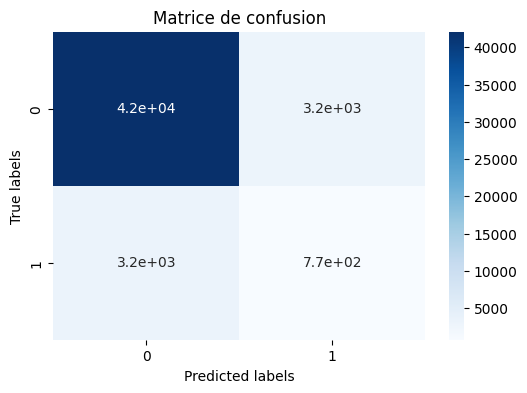

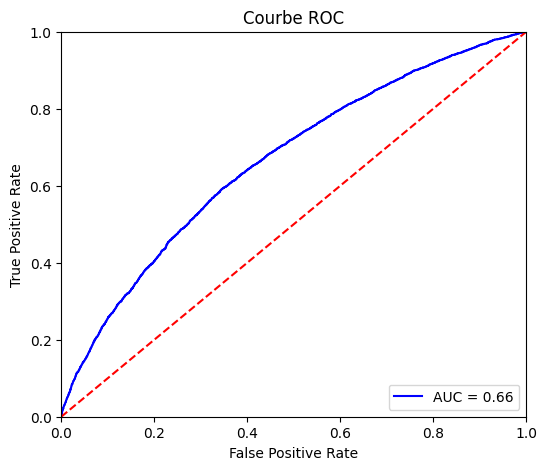

2025/01/06 17:34:21 INFO mlflow.tracking._tracking_service.client: 🏃 View run LogisticRegression upsampling at: http://127.0.0.1:5000/#/experiments/0/runs/89a6cb3e701e4aeab9c9b66cbe888e7b.
2025/01/06 17:34:21 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [61]:
# Rééquilibrage avec Sur-échantillonnage (upsampling) de la classe minoritaire : SMOTE 

import numpy as np
from collections import Counter
from sklearn.linear_model import LogisticRegression
from imblearn.over_sampling import SMOTE
import mlflow

# Assurer que y_train contient des valeurs discrètes
y_train = y_train.astype(int)

# Définition de l'instance SMOTE
sm = SMOTE(random_state=0)

# Application du SMOTE aux données
X_train_sm, y_train_sm = sm.fit_resample(X_train_scaled, y_train)

print('Equilibre des classes : {}'.format(Counter(y_train_sm)))

with mlflow.start_run(run_name='LogisticRegression upsampling'):
    reg_log_up = LogisticRegression(max_iter=1000, random_state=0)
    reg_log_up.fit(X_train_sm, y_train_sm)
    
    # Calcul et enregistrement des métriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba = \
    eval_score(reg_log_up, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

### 4.1.4 Rééquilibrage avec Sous-échantillonnage : Tomek Links

L'undersampling (sous-échantillonnage) est une technique utilisée pour remédier au déséquilibre de classes dans un jeu de données, où une classe est sur-représentée par rapport à une autre classe. L'objectif de l'undersampling est de réduire le nombre d'échantillons de la classe majoritaire afin d'équilibrer les classes et d'améliorer les performances du modèle.

Tomek Links est une approche de sous-échantillonnage de la classe majoritaire. L’idée est de chercher les points de la classe majoritaire qui sont assez proches d’un point de la classe minoritaire. Les paires de points identifiées sont appelées tomek links. Dans chaque tomek link on va retirer le point qui appartient à la classe majoritaire.

Equilibre des classes : Counter({0: 226145, 1: 19860})
Equilibre des classes : Counter({0: 220839, 1: 19860})


C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Score métier :0.13
Accuracy score : 0.92
Precision score : 0.50
Recall score : 0.03
F1 score : 0.05
Fbeta score : 0.04
ROC AUC score : 0.75


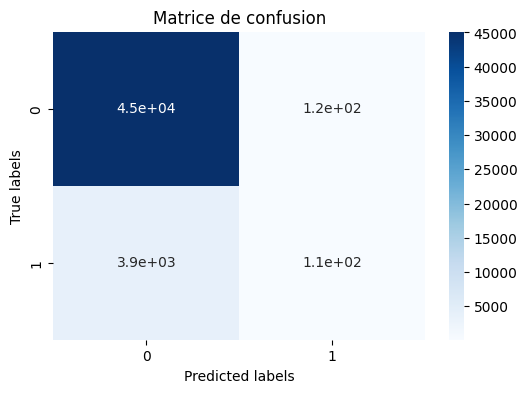

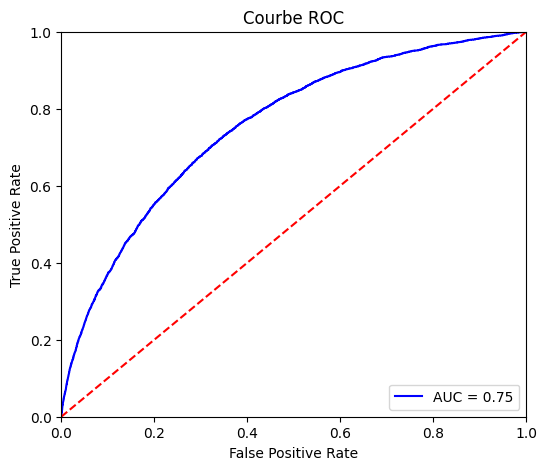

2025/01/06 17:58:42 INFO mlflow.tracking._tracking_service.client: 🏃 View run LogisticRegression undersampling at: http://127.0.0.1:5000/#/experiments/0/runs/db1500408c8f40e4ac6948e5ecfadfc2.
2025/01/06 17:58:42 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [62]:
# Rééquilibrage avec Sous-échantillonnage (undersampling) de la classe majoritaire : Tomek Links

print('Equilibre des classes : {}'.format(Counter(y_train)))

# Création de l'objet TomekLinks
tomek_links = TomekLinks()

# Sous-échantillonnage en utilisant Tomek Links
X_train_tl, y_train_tl = tomek_links.fit_resample(X_train_scaled, y_train)

print('Equilibre des classes : {}'.format(Counter(y_train_tl)))


with mlflow.start_run(run_name='LogisticRegression undersampling'):
    reg_log_under = LogisticRegression(max_iter=1000, random_state=0)
    reg_log_under.fit(X_train_tl, y_train_tl)
    
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(reg_log_under, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

Equilibre des classes : Counter({0: 226145, 1: 19860})
Equilibre des classes : Counter({0: 19860, 1: 19860})


C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Score métier :0.39
Accuracy score : 0.70
Precision score : 0.17
Recall score : 0.69
F1 score : 0.27
Fbeta score : 0.42
ROC AUC score : 0.76


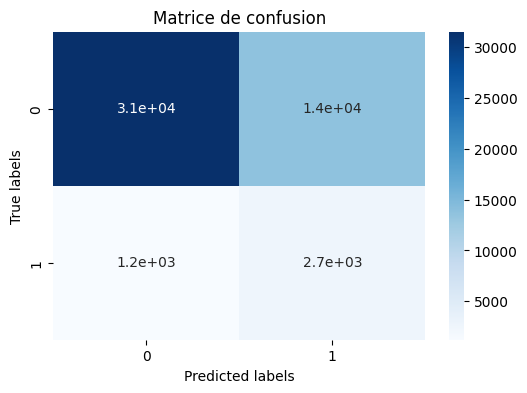

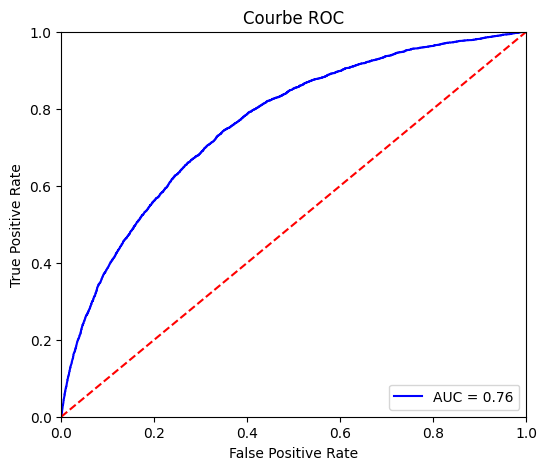

2025/01/06 23:32:16 INFO mlflow.tracking._tracking_service.client: 🏃 View run LogisticRegression undersampling Random at: http://127.0.0.1:5000/#/experiments/0/runs/b5e1ff2ab7cf4165b3756e1530f69442.
2025/01/06 23:32:16 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [63]:
# Rééquilibrage avec Sous-échantillonnage (undersampling) de la classe majoritaire : RandomUnderSampler

print('Equilibre des classes : {}'.format(Counter(y_train)))

# Création de l'objet TomekLinks
under = RandomUnderSampler()

# Sous-échantillonnage en utilisant RandomUnderSampler
X_train_under, y_train_under = under.fit_resample(X_train_scaled, y_train)

print('Equilibre des classes : {}'.format(Counter(y_train_under)))


with mlflow.start_run(run_name='LogisticRegression undersampling Random'):
    reg_log_under_r = LogisticRegression(max_iter=1000, random_state=0)
    reg_log_under_r.fit(X_train_under, y_train_under)
    
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(reg_log_under_r, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

### 4.1.5 Combinaison d'oversampling et undersampling : SMOTETomek

SMOTETomek est une technique combinant l'oversampling (SMOTE) et l'undersampling (Tomek Links). Elle vise à résoudre le déséquilibre de classes en augmentant la classe minoritaire par synthèse d'échantillons (SMOTE) tout en réduisant la classe majoritaire en supprimant les exemples qui se trouvent à la frontière entre les classes (Tomek Links).

In [64]:
# Combinaison d'oversampling et d'undersampling : SMOTE (oversampling) et Tomek Links (undersampling)

print('Equilibre des classes : {}'.format(Counter(y_train)))

# Création de l'objet SMOTETomek
smote_tomek = SMOTETomek(random_state=0)

# Sous-échantillonnage en utilisant SMOTETomek
X_train_st, y_train_st = smote_tomek.fit_resample(X_train_scaled, y_train)

print('Equilibre des classes : {}'.format(Counter(y_train_st)))

Equilibre des classes : Counter({0: 226145, 1: 19860})


Equilibre des classes : Counter({0: 225497, 1: 225497})


C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Score métier :0.21
Accuracy score : 0.87
Precision score : 0.20
Recall score : 0.20
F1 score : 0.20
Fbeta score : 0.20
ROC AUC score : 0.66


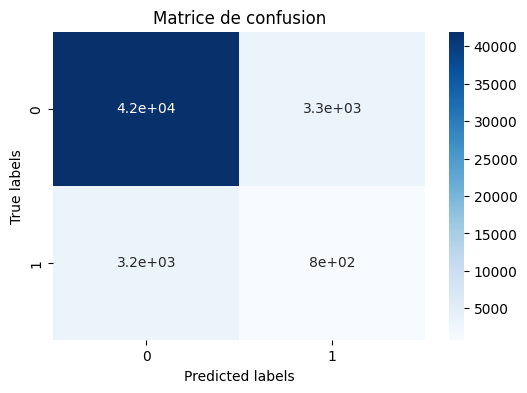

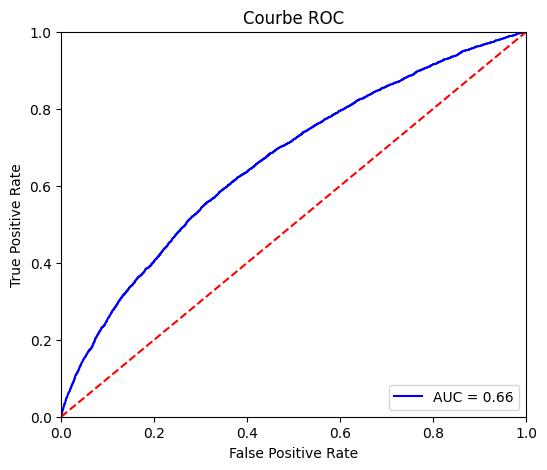

2025/01/07 01:29:52 INFO mlflow.tracking._tracking_service.client: 🏃 View run LogisticRegression combinaison at: http://127.0.0.1:5000/#/experiments/0/runs/4ddb251a16634f0a86e902f51cd5a3b7.
2025/01/07 01:29:52 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [65]:
with mlflow.start_run(run_name='LogisticRegression combinaison'):
    reg_log_combi = LogisticRegression(max_iter=1000, random_state=0)
    reg_log_combi.fit(X_train_st, y_train_st)
    
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(reg_log_combi, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

On choisit la méthode d'undersampling avec *RandomUnderSampler* pour le rééquilibrage de nos données.
En effet les méthodes *class_weight* et *RandomUnderSampler* offrent les meilleurs résultats de score métier. Cependant, l'argument *class_weight* n'est pas disponible pour tous les modèles. De plus, le temps d'exécution de *RandomUnderSampler* est bien inférieur à ceux des autres méthodes. Nous privilégions donc *RandomUnderSampler* afin de pouvoir tester plus de modèles.

In [66]:
# enregistrer le df train rééquilibré 
pickle.dump(X_train_under, open('models/X_train_under.pkl', 'wb'))
pickle.dump(y_train_under, open('models/y_train_under.pkl', 'wb'))

In [67]:
X_train_scaled = pickle.load(open('models/X_train_under.pkl', 'rb'))
y_train = pickle.load(open('models/y_train_under.pkl', 'rb'))

## <a id="6"></a> 4.2 Premières modélisations

Nous allons désormais tester différents algorithmes que nous avons séléctionné, de manière basique, sans optimisation des hyperparamètres. Nous allons travailler sur les algorithmes suivants : 
- **Dummy Classifier (baseline)** : ne prend pas en compte les caractéristiques du jeu de données et se contente de faire des prédictions en utilisant des règles simples. Ici, on renvoie l'étiquette de classe la plus fréquente dans l'argument y observé. 
- **Logistic Regression** : le but est de trouver une relation mathématique entre les variables d'entrée (features) et la variable de sortie (classe prédite). Cette relation est généralement exprimée sous la forme d'une fonction logistique qui transforme la sortie en une probabilité.
- **Random Forest** : algorithme d'apprentissage automatique qui combine plusieurs arbres de décision pour effectuer des prédictions. Chaque arbre de la forêt donne une prédiction et la classe prédite est déterminée par un vote majoritaire.
- **XG Boost** : utilise un ensemble de modèles d'arbres de décision pour effectuer des prédictions. L'algorithme fonctionne en itérations successives pour minimiser une fonction de perte spécifiée et ajouter des arbres qui réduisent cette perte.
- **Light GBM** : algorithme d'apprentissage automatique basé sur le gradient boosting qui est conçu pour offrir une exécution rapide et des performances élevées. Il utilise une technique d'échantillonnage basée sur le gradient pour sélectionner les échantillons les plus informatifs pendant le processus d'apprentissage.

### 4.2.1 Dummy Classifier

C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Score métier :0.11
Accuracy score : 0.92
Precision score : 0.00
Recall score : 0.00
F1 score : 0.00
Fbeta score : 0.00
ROC AUC score : 0.50


C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


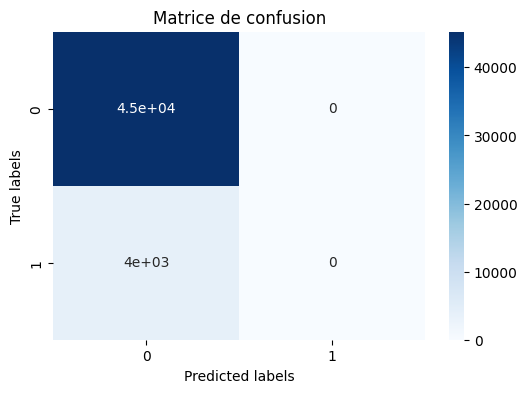

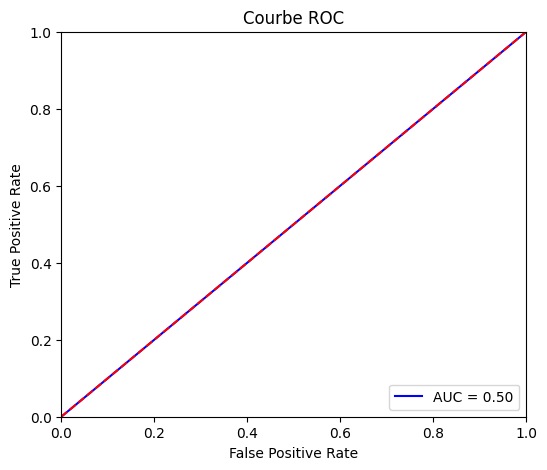

2025/01/07 01:31:28 INFO mlflow.tracking._tracking_service.client: 🏃 View run Dummy Classifier at: http://127.0.0.1:5000/#/experiments/0/runs/5f03f8e217e948c0ab7c4f1d77a1ce8e.
2025/01/07 01:31:28 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [68]:
with mlflow.start_run(run_name='Dummy Classifier'):
    dummy = DummyClassifier(random_state=0)
    dummy.fit(X_train_scaled, y_train)
    
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(dummy, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

Grâce à la matrice de confusion, on constate que le Dummy Classifier prédit bien seulement la classe 0 (client ne faisant pas défaut) et contient donc beaucoup de faux négatifs (mauvais client prédit bon client). C'est la raison pour laquelle il possède un score métier relativement faible (car ce dernier pénalise plus fortement les faux négatifs).

La plupart de nos scores sont à 0 puisque le modèle ne prédit aucune valeur positive. Les scores sont donc estimés à 0 puisque cela engendre une division par 0.

On constate que l'AUC est de 0.5 comme c'est le cas pour les modèles baseline.

Score métier maximum : 0.11
Threshold optimal : 0.5


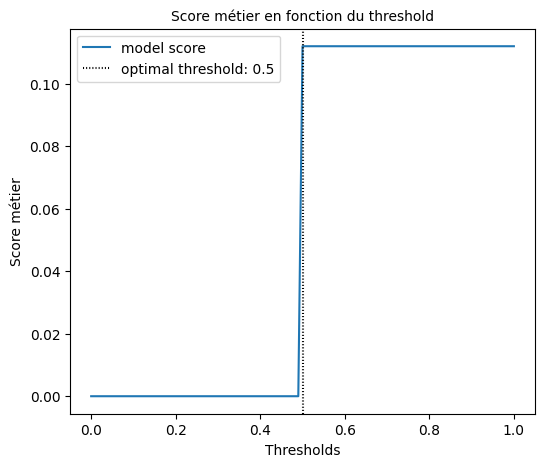

In [71]:
score_metier_max(y_pred_proba, y_val, verbose=True)

### 4.2.2 Logistic Regression

C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Score métier :0.39
Accuracy score : 0.70
Precision score : 0.17
Recall score : 0.69
F1 score : 0.27
Fbeta score : 0.42
ROC AUC score : 0.76


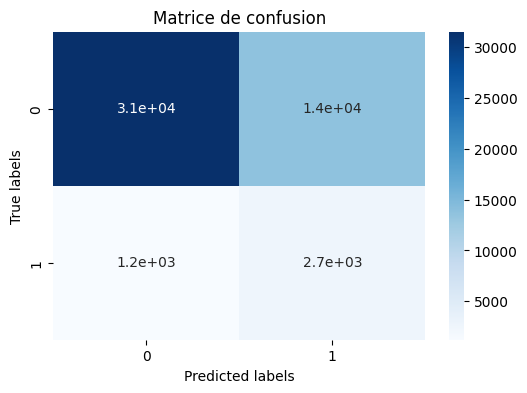

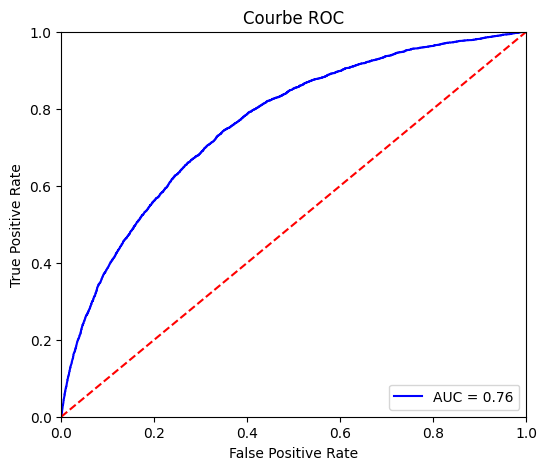

2025/01/07 10:03:45 INFO mlflow.tracking._tracking_service.client: 🏃 View run Logistic Regression at: http://127.0.0.1:5000/#/experiments/0/runs/c9744929bdd1415794c72e26ca8e18e7.
2025/01/07 10:03:45 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [76]:
# y_train est modifiable en faisant une copie
y_train = y_train.copy()

# Entraînement du modèle avec MLflow
with mlflow.start_run(run_name='Logistic Regression'):
    reg_log = LogisticRegression(max_iter=1000, random_state=0)
    reg_log.fit(X_train_scaled, y_train)
    
    # Calcul et enregistrement des métriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba = eval_score(reg_log, X_val_scaled, y_val)
    
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)


Le score métier est nettement plus élevé à 0.39.

La matrice de confusion nous permet de constater que les FN sont présents en moins grande quantité que les autres catégories. Le modèle présente cependant une grande quantité de FP.

Le f-béta score est effectivement plus élevé que le f-score puisque le recall est plus élevé que la précision, ce score étant établit ici pour privilégier le recall à la précision. 

On constate que le score ROC AUC est amélioré par rapport à la baseline et est de 0.76.

Score métier maximum : 0.39
Threshold optimal : 0.53


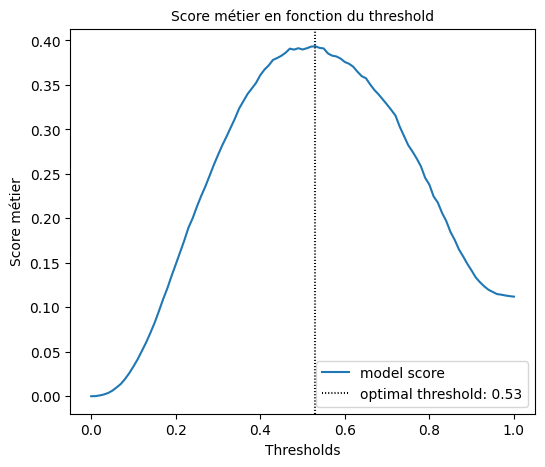

In [77]:
score_metier_max(y_pred_proba, y_val, verbose=True)

Le score métier semble optimal quand le seuil est fixé à 0.53, cependant l'augmentation est minime.

### Random Forest Classifier

Score métier :0.37
Accuracy score : 0.70
Precision score : 0.16
Recall score : 0.66
F1 score : 0.26
Fbeta score : 0.41
ROC AUC score : 0.74


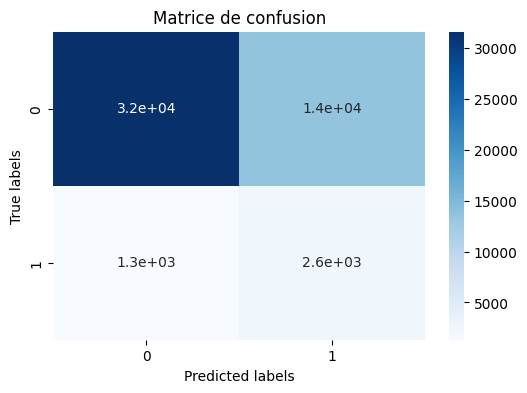

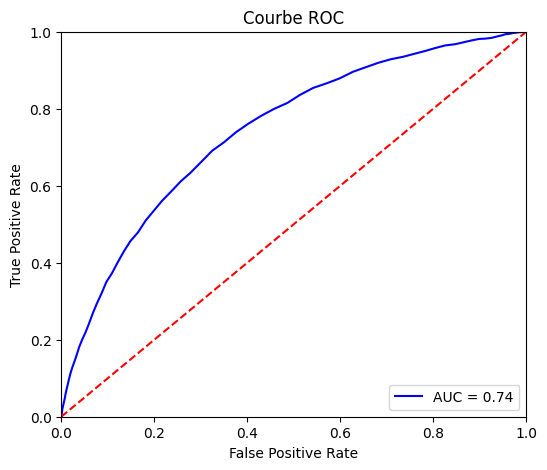

2025/01/07 10:22:57 INFO mlflow.tracking._tracking_service.client: 🏃 View run Random Forest at: http://127.0.0.1:5000/#/experiments/0/runs/ff989613123d4b28b92c28950a2f22c7.
2025/01/07 10:22:57 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [78]:
# y_train est modifiable en faisant une copie
y_train = y_train.copy()
with mlflow.start_run(run_name='Random Forest'):
    rf = RandomForestClassifier(random_state=0)
    rf.fit(X_train_scaled, y_train)
    
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(rf, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

Le score métier est légèrement dégradé par rapport à la regression logistique à 0.37.

La matrice de confusion nous permet de constater que les FN sont présents en moins grande quantité que les autres catégories. Le modèle présente cependant une grande quantité de FP.

Le f-béta score est effectivement plus élevé que le f-score puisque le recall est plus élevé que la précision, ce score étant établit ici pour privilégier le recall à la précision. 

On constate que le score ROC AUC est amélioré par rapport à la baseline et est de 0.74.

Score métier maximum : 0.37
Threshold optimal : 0.49


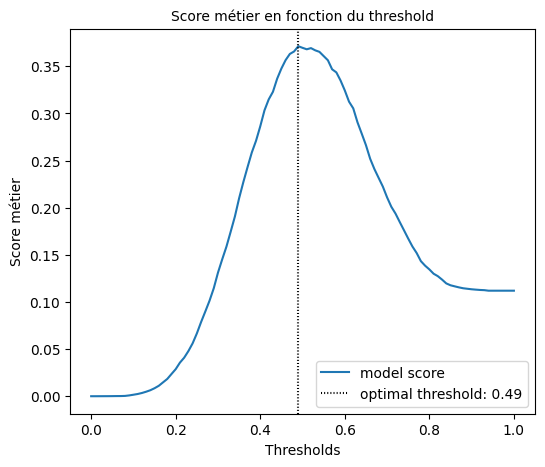

In [79]:
score_metier_max(y_pred_proba, y_val, verbose=True)

Le score métier semble optimal quand le seuil est fixé à 0.49, cependant l'augmentation est minime.

### 4.2.6 XGBoost Classifier

Score métier :0.39
Accuracy score : 0.70
Precision score : 0.17
Recall score : 0.69
F1 score : 0.27
Fbeta score : 0.42
ROC AUC score : 0.76


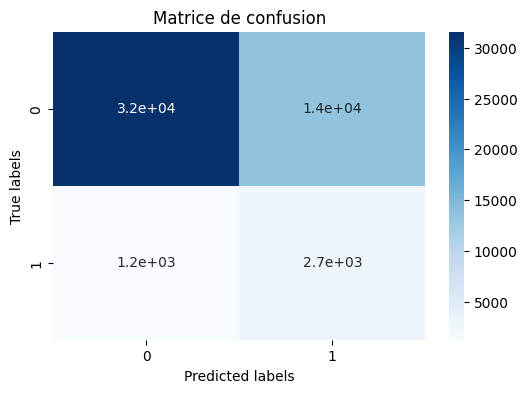

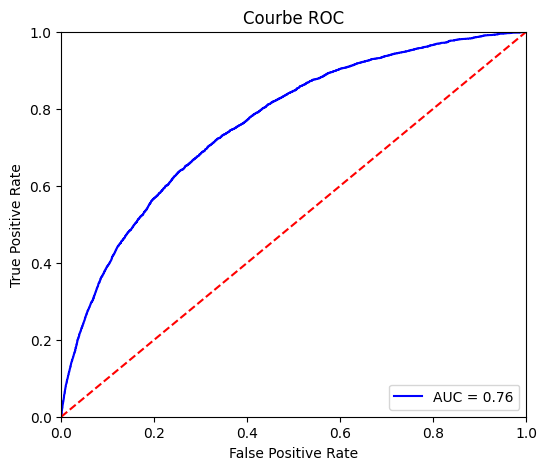

2025/01/07 10:33:02 INFO mlflow.tracking._tracking_service.client: 🏃 View run XGBoost Classifier at: http://127.0.0.1:5000/#/experiments/0/runs/80df726e40804ec992e94434dce2f9ec.
2025/01/07 10:33:02 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [80]:
# y_train est modifiable en faisant une copie
y_train = y_train.copy()
with mlflow.start_run(run_name='XGBoost Classifier'):
    xgb = XGBClassifier(random_state=0)
    xgb.fit(X_train_scaled, y_train)
    
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(xgb, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

Le score métier est légèrement plus élevé par rapport à Random Forest à 0.39.

La matrice de confusion nous permet de constater que les FN sont présents en moins grande quantité que les autres catégories. Le modèle présente cependant une grande quantité de FP.

Le f-béta score est effectivement plus élevé que le f-score puisque le recall est plus élevé que la précision, ce score étant établit ici pour privilégier le recall à la précision. 

On constate que le score ROC AUC est amélioré par rapport à la baseline et est de 0.76.

Score métier maximum : 0.39
Threshold optimal : 0.55


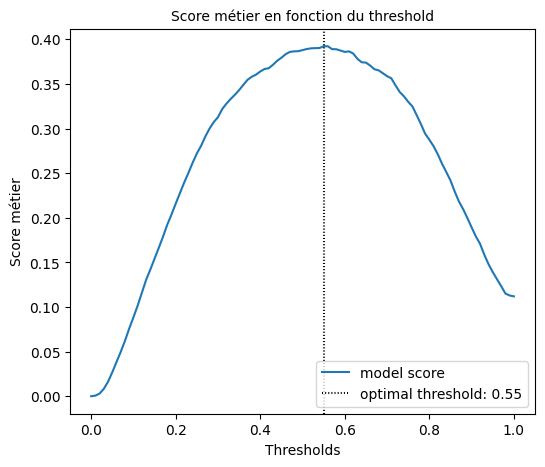

In [81]:
score_metier_max(y_pred_proba, y_val, verbose=True)

Le score métier semble optimal quand le seuil est fixé à 0.55.

### 4.2.7 Light GBM

[LightGBM] [Info] Number of positive: 19860, number of negative: 19860
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.238545 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 51729
[LightGBM] [Info] Number of data points in the train set: 39720, number of used features: 498
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


Score métier :0.42
Accuracy score : 0.71
Precision score : 0.18
Recall score : 0.71
F1 score : 0.28
Fbeta score : 0.44
ROC AUC score : 0.78


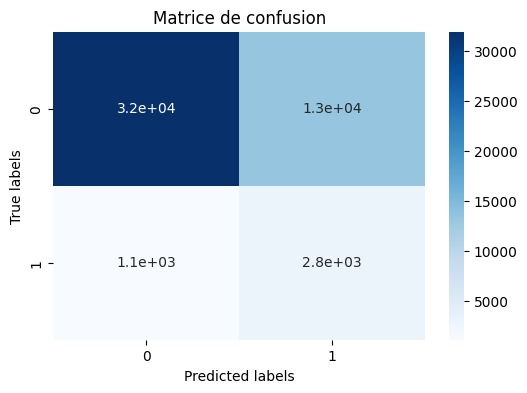

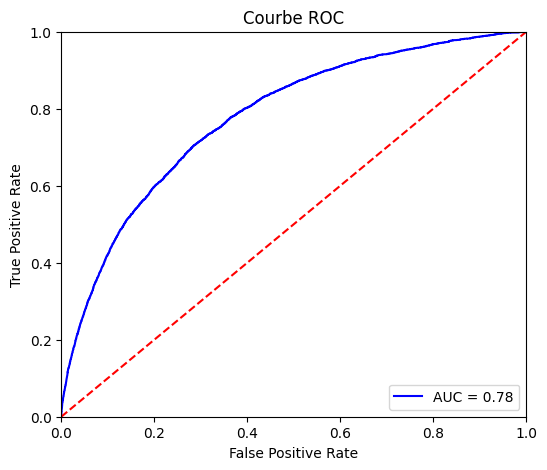

2025/01/07 10:43:59 INFO mlflow.tracking._tracking_service.client: 🏃 View run LGBM Classifier at: http://127.0.0.1:5000/#/experiments/0/runs/832234c7ad8a4c42aa7d818741d970f6.
2025/01/07 10:43:59 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [82]:
# y_train est modifiable en faisant une copie
y_train = y_train.copy()
with mlflow.start_run(run_name='LGBM Classifier'):
    lgbm = LGBMClassifier(random_state=0)
    lgbm.fit(X_train_scaled, y_train)
    
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(lgbm, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

Le score métier est légèrement plus élevé par rapport à XGBoots à 0.42.

La matrice de confusion nous permet de constater que les FN sont présents en moins grande quantité que les autres catégories. Le modèle présente cependant une grande quantité de FP.

Le f-béta score est effectivement plus élevé que le f-score puisque le recall est plus élevé que la précision, ce score étant établit ici pour privilégier le recall à la précision. 

On constate que le score ROC AUC est amélioré par rapport à la baseline et est de 0.71.

Score métier maximum : 0.42
Threshold optimal : 0.51


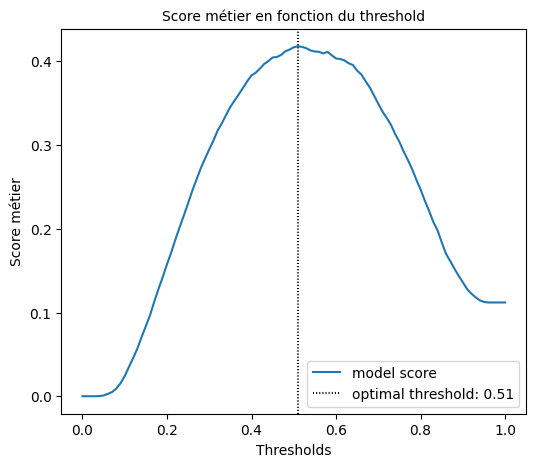

In [83]:
score_metier_max(y_pred_proba, y_val, verbose=True)

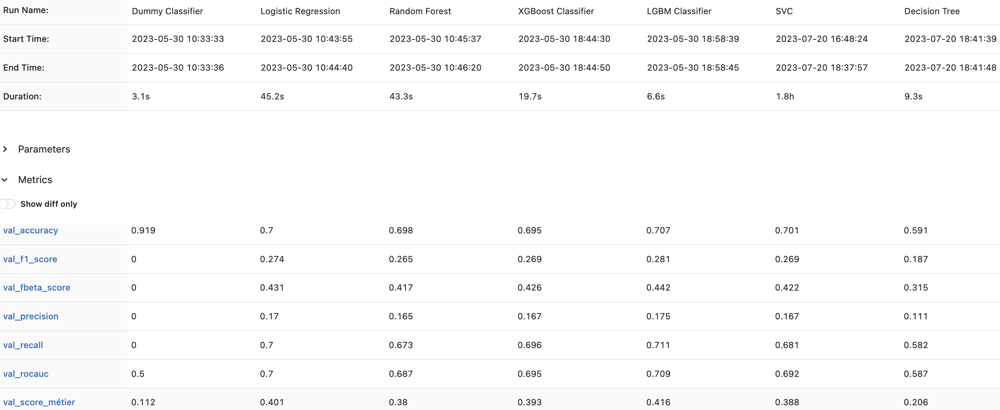

Pour le moment on peut constater que LightGBM présente le meilleur score métier (0.42) suivi par la regression logistique avec un score de 0.40. 

Les courbes du score métier en fonction du seuil on été tracé et on constate que les meilleurs seuils se situent tous autour de 0.5 puisque le dataset que nous utilisons est équilibré.

Nous allons désormais optimiser nos modèles en testant différents hyperparamètres.

## <a id="7"></a> 4.3 Optimisation des modèles

### 4.3.1 Logistic Regression

In [84]:
score_metier = metrics.make_scorer(fonction_metier, greater_is_better=True)

In [85]:
params = {'penalty':['l1', 'l2', 'elasticnet'],
          'C':[1e-5, 1e-2, 1, 10, 100],
          'solver':['newton-cg', 'lbfgs', 'liblinear']
         }

with mlflow.start_run(run_name='Grid logistic regression'):
    reg_log = LogisticRegression(max_iter=1000, random_state=0)
    grid_reg_log = GridSearchCV(
        reg_log,
        param_grid=params,
        cv=5,
        scoring=score_metier,
        return_train_score = True,
        n_jobs = -1)
    
    grid_reg_log.fit(X_train_scaled, y_train)

C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py:540: FitFailedWarning: 
125 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
25 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py", line 1473, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\o

In [91]:
# Récupération des meilleurs paramètres
best_params = grid_reg_log.best_params_
print("Meilleurs paramètres :", best_params)

# Récupérer les résultats de la recherche en grille
result_reg_log = pd.DataFrame(grid_reg_log.cv_results_)

# Afficher les résultats pour les meilleurs paramètres
print("Résultats des meilleurs paramètres :\n")
display(result_reg_log.loc[result_reg_log['params'] == best_params])


Meilleurs paramètres : {'C': 10, 'penalty': 'l1', 'solver': 'liblinear'}
Résultats des meilleurs paramètres :



,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_penalty,param_solver,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
29,1190.927294,650.590405,0.691299,0.097834,10.0,l1,liblinear,"{'C': 10, 'penalty': 'l1', 'solver': 'liblinear'}",-1.149295,-1.086858,-1.18215,-1.148288,-1.143127,-1.141944,0.030811,1,-1.073515,-1.078581,-1.062531,-1.084026,-1.09139,-1.078009,0.00975


In [92]:
def plot_learning_curve(estimator, X, y):
    '''Affiche la courbe d'apprentissage.
    :param: estimator (meilleur estiateur de la grid search), X (valeurs), y (target)    
    '''
    
    train_sizes, train_scores, test_scores = learning_curve(estimator=estimator, X=X, y=y, cv=5, 
                                                            train_sizes=np.linspace(0.1, 1.0, 10),
                                                            n_jobs= -1, verbose=0)
    
    train_mean = np.mean(train_scores, axis=1)
    train_std = np.std(train_scores, axis=1)
    test_mean = np.mean(test_scores, axis=1)
    test_std = np.std(test_scores, axis=1)
    
    plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training Score')
    plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.15, color='blue')
    plt.plot(train_sizes, test_mean, color='green', marker='+', markersize=5, linestyle='--', label='Validation Score')
    plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha=0.15, color='green')
    plt.title('Learning Curve')
    plt.xlabel('Training Data Size')
    plt.ylabel('Performance score métier')
    plt.grid()
    plt.legend(loc='lower right')
    plt.show()

C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py:540: FitFailedWarning: 
25 fits failed out of a total of 50.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
25 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py", line 1473, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\oze

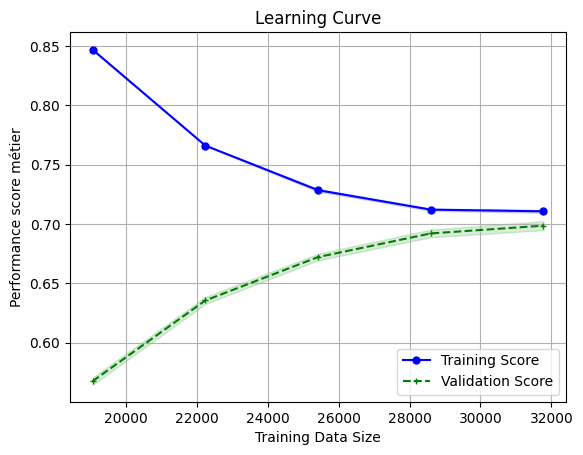

In [93]:
plot_learning_curve(grid_reg_log.best_estimator_, X_train_scaled, y_train)

Score métier :0.40
Accuracy score : 0.70
Precision score : 0.17
Recall score : 0.70
F1 score : 0.27
Fbeta score : 0.43
ROC AUC score : 0.77


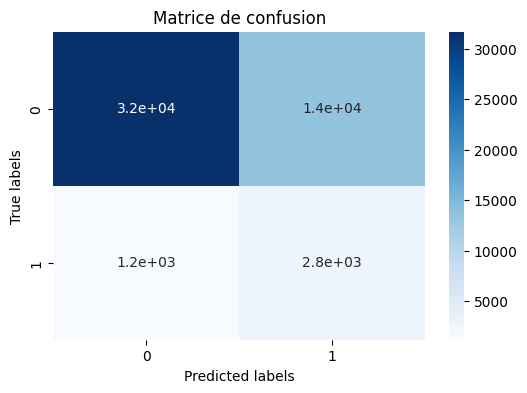

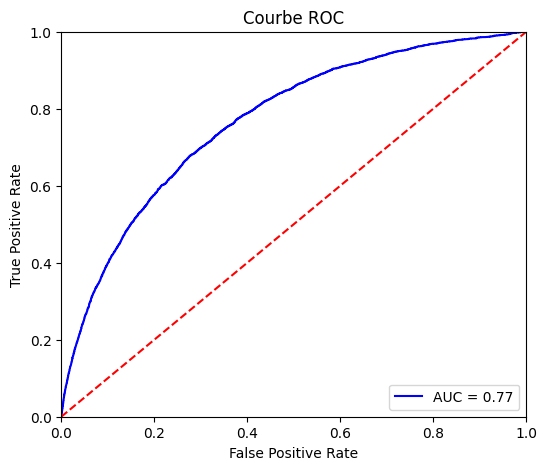

2025/01/07 12:11:19 INFO mlflow.tracking._tracking_service.client: 🏃 View run Logistic regression optimise at: http://127.0.0.1:5000/#/experiments/0/runs/726a4a5b33984c21af3dd173a3f3fe50.
2025/01/07 12:11:19 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [94]:
with mlflow.start_run(run_name='Logistic regression optimise'):
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(grid_reg_log, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

Score métier maximum : 0.40
Threshold optimal : 0.52


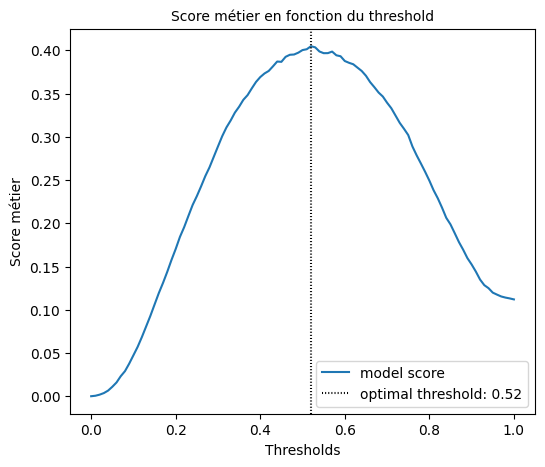

In [96]:
score_metier_max(y_pred_proba, y_val, verbose=True)

Après optimisation des hyperparamètres, nous obtenons un score métier à 0.40, ce qui ne change pas par rapport au modèle de base. Les hyperparamètres optimaux ne semblent pas avoir d'impact significatifs sur les performances de notre modèle.

###  Random Forest Classifier

In [98]:
score_metier = metrics.make_scorer(fonction_metier, greater_is_better=True)
params = {'n_estimators' : [100, 500, 1000, 2000],
          'max_depth': [2, 5, 10, None],
         }

with mlflow.start_run(run_name='Grid random forest'):
    rand_fo = RandomForestClassifier(random_state=0)
    grid_rand_fo = GridSearchCV(
        rand_fo,
        param_grid=params,
        cv=5,
        scoring=score_metier,
        return_train_score = True,
        n_jobs = -1)
    
    grid_rand_fo.fit(X_train_scaled, y_train)

C:\Users\ozenzamy\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_search.py:1052: UserWarning: One or more of the train scores are non-finite: [-1.57825403 -1.54954683 -1.56305388 -1.56760448 -1.25735775 -1.25806269
 -1.26142372 -1.26158107 -0.46187689 -0.44164778 -0.44117573 -0.44294436
  0.5         0.5                nan  0.5       ]
  warnings.warn(
2025/01/07 13:43:27 INFO mlflow.tracking._tracking_service.client: 🏃 View run Grid random forest at: http://127.0.0.1:5000/#/experiments/0/runs/d4113b1cf0fe4a1186791f92e9a774aa.
2025/01/07 13:43:27 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [99]:
result_rand_fo = pd.DataFrame(grid_rand_fo.cv_results_)
result_rand_fo.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,10.741876,0.664244,0.249382,0.078551,2.0,100,"{'max_depth': 2, 'n_estimators': 100}",-1.567472,-1.711858,-1.539149,-1.639099,-1.577543,-1.607024,0.061740,16,-1.548433,-1.613922,-1.533484,-1.613356,-1.582075,-1.578254,0.032902
1,42.248554,0.642617,0.429051,0.063076,2.0,500,"{'max_depth': 2, 'n_estimators': 500}",-1.565332,-1.658359,-1.528323,-1.603600,-1.518756,-1.574874,0.051385,13,-1.538771,-1.566811,-1.516333,-1.583019,-1.542800,-1.549547,0.023166
2,81.160901,0.757605,0.642644,0.048229,2.0,1000,"{'max_depth': 2, 'n_estimators': 1000}",-1.589250,-1.678751,-1.532226,-1.626511,-1.534114,-1.592170,0.055943,14,-1.552650,-1.580249,-1.525082,-1.607912,-1.549377,-1.563054,0.028443
3,158.796721,0.967689,1.056725,0.068152,2.0,2000,"{'max_depth': 2, 'n_estimators': 2000}",-1.563066,-1.700151,-1.533107,-1.619587,-1.556647,-1.594512,0.059969,15,-1.546796,-1.597747,-1.528575,-1.611342,-1.553562,-1.567604,0.031544
4,20.593932,0.351906,0.220604,0.035395,5.0,100,"{'max_depth': 5, 'n_estimators': 100}",-1.355866,-1.397155,-1.321123,-1.394008,-1.312059,-1.356042,0.035456,10,-1.259535,-1.277348,-1.253053,-1.251762,-1.245091,-1.257358,0.010997


In [100]:
print('Meilleurs paramètres',grid_rand_fo.best_params_)
print("Résultats des meilleurs paramètres :\n")
display(result_rand_fo.loc[result_rand_fo['params']==grid_rand_fo.best_params_])

Meilleurs paramètres {'max_depth': None, 'n_estimators': 2000}
Résultats des meilleurs paramètres :



,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
15,1083.934733,84.767809,13.382995,2.771705,NaN,2000,"{'max_depth': None, 'n_estimators': 2000}",-1.244713,-1.223565,-1.242069,-1.255539,-1.243706,-1.241918,0.010329,1,0.5,0.5,0.5,0.5,0.5,0.5,0.0


Score métier :0.39
Accuracy score : 0.70
Precision score : 0.17
Recall score : 0.69
F1 score : 0.27
Fbeta score : 0.42
ROC AUC score : 0.76


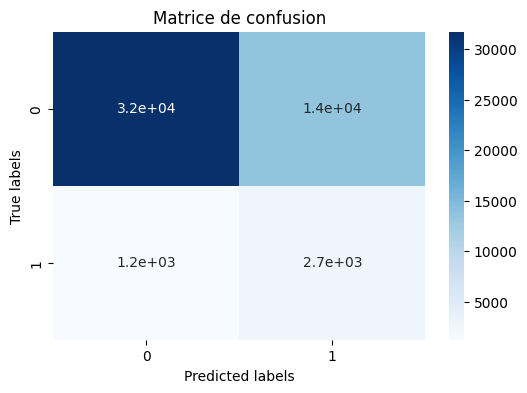

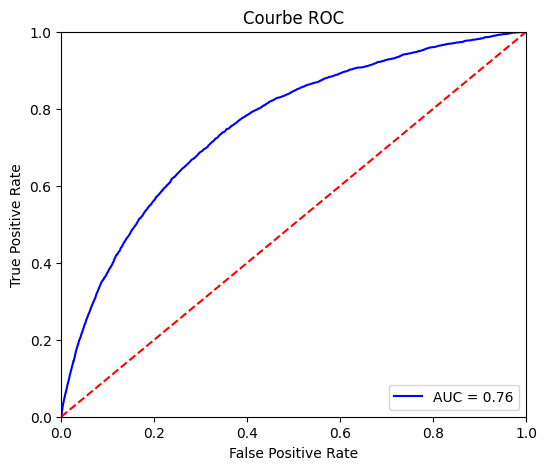

2025/01/07 13:54:15 INFO mlflow.tracking._tracking_service.client: 🏃 View run Random forest optimise at: http://127.0.0.1:5000/#/experiments/0/runs/2ca03204b43a4520a66e949b12444d2d.
2025/01/07 13:54:15 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


In [103]:
with mlflow.start_run(run_name='Random forest optimise'):
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(grid_rand_fo, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

Score métier maximum : 0.39
Threshold optimal : 0.51


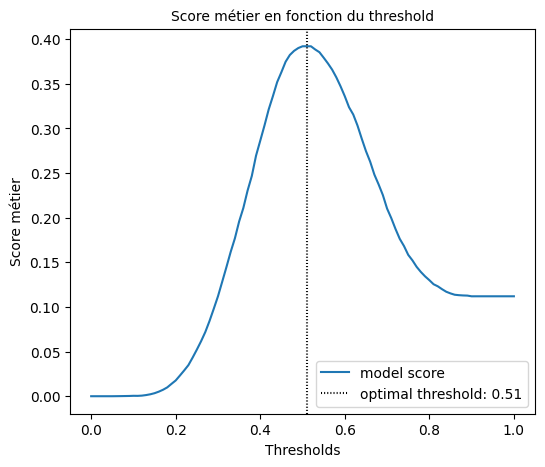

In [105]:
score_metier_max(y_pred_proba, y_val, verbose=True)

Après optimisation des hyperparamètres, nous obtenons un score métier à 0.39, qui est légèrement plus élevé que celui du modèle de base.

### 4.3.5 XGBoost Classifier

In [39]:
score_metier = metrics.make_scorer(fonction_metier, greater_is_better=True)
params = {'gamma': [0, 0.1, 0.5, 1],
          'max_depth': [2,4,6],
          'min_child_weight' : [1,5,10],
          'n_estimators': [100, 300, 500],
         }

# Assurez-vous que les tableaux sont modifiables 
X_train_scaled = X_train_scaled.copy() 
y_train = y_train.copy()

with mlflow.start_run(run_name='Grid XGBoost'):
    xgb = XGBClassifier(random_state=0)
    grid_xgb = GridSearchCV(
        xgb,
        param_grid=params,
        cv=5,
        scoring=score_metier,
        return_train_score = True,
        n_jobs = -1)
    
    grid_xgb.fit(X_train_scaled, y_train)

2025/01/07 14:33:18 INFO mlflow.tracking._tracking_service.client: 🏃 View run Grid XGBoost at: http://127.0.0.1:5000/#/experiments/0/runs/526cf48c25194305b6efcb418121edf2.
2025/01/07 14:33:18 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


MemoryError: Unable to allocate 60.1 MiB for an array with shape (40, 196804) and data type int64

In [ ]:
result_xgb = pd.DataFrame(grid_xgb.cv_results_)
result_xgb.head()

In [ ]:
print('Meilleurs paramètres',grid_xgb.best_params_)
print("Résultats des meilleurs paramètres :\n")
display(result_xgb.loc[result_xgb['params']==grid_xgb.best_params_])

In [ ]:
plot_learning_curve(grid_xgb.best_estimator_, X_train_scaled, y_train)

In [ ]:
with mlflow.start_run(run_name='XGBoost optimise'):
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(grid_xgb, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

In [ ]:
score_metier_max(y_pred_proba, X_val_scaled, y_val, verbose=True)

Après optimisation des hyperparamètres, nous obtenons un score métier à 0.41, qui est plus élevé que celui du modèle de base.

### 4.3.6 Light GBM

In [43]:
score_metier = metrics.make_scorer(fonction_metier, greater_is_better=True)
params = {'n_estimators' : [100, 300, 500],
          'max_depth': [-1, 2, 5],
          'num_leaves': [15, 31, 63]
         }

with mlflow.start_run(run_name='Grid Light GBM'):
    lgbm = LGBMClassifier(random_state=0)
    grid_lgbm = GridSearchCV(
        lgbm,
        param_grid=params,
        cv=5,
        scoring=score_metier,
        return_train_score = True,
        n_jobs = -1)
    
    grid_lgbm.fit(X_train_scaled, y_train)

2025/01/07 15:21:43 INFO mlflow.tracking._tracking_service.client: 🏃 View run Grid Light GBM at: http://127.0.0.1:5000/#/experiments/0/runs/384788ec68844b88a4fb48eb984a38a4.
2025/01/07 15:21:43 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


MemoryError: Unable to allocate 60.1 MiB for an array with shape (40, 196804) and data type int64

In [ ]:
result_lgbm = pd.DataFrame(grid_lgbm.cv_results_)
result_lgbm.head()

In [ ]:
print('Meilleurs paramètres',grid_lgbm.best_params_)
print("Résultats des meilleurs paramètres :\n")
display(result_lgbm.loc[result_lgbm['params']==grid_lgbm.best_params_])

In [ ]:
plot_learning_curve(grid_lgbm.best_estimator_, X_train_scaled, y_train)

In [ ]:
with mlflow.start_run(run_name='Light GBM optimise'):
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(grid_lgbm, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

In [ ]:
score_metier_max(y_pred_proba, X_val_scaled, y_val, verbose=True)

Après optimisation des hyperparamètres, nous obtenons un score métier à 0.42, ce qui ne change pas par rapport au modèle de base. Les hyperparamètres optimaux ne semblent pas avoir d'impact significatifs sur les performances de notre modèle.


## <a id="8"></a> 4.4 Selection du modèle

Le modèle Light GBM avec les hyperparamètres suivants : *'max_depth': 5, 'n_estimators': 300, 'num_leaves': 31*
est le modèle le plus performant. Nous allons donc utiliser ce modèle par la suite. Nous décidons dans un premier temps de réaliser une grid search plus poussée avec l'algorithme Light GBM afin de tenter d'obtenir de meilleures performances.

In [44]:
score_metier = metrics.make_scorer(fonction_metier, greater_is_better=True)

In [47]:
params = {'n_estimators' : [100, 300, 500, 800],
          'max_depth': [-1, 2, 5, 7],
          'num_leaves': [7, 15, 31, 63, 127],
          'learning_rate': [0.05, 0.1, 0.2, 0.4]
         }

mlflow.lightgbm.autolog(log_input_examples=True, silent=True)
with mlflow.start_run(run_name='Grid finale Light GBM'):
    lgbm_fin = LGBMClassifier(random_state=0)
    grid_lgbm_fin = GridSearchCV(
        lgbm_fin,
        param_grid=params,
        cv=5,
        scoring=score_metier,
        return_train_score = True,
        n_jobs = -1)
    
    grid_lgbm_fin.fit(X_train_scaled, y_train)

2025/01/07 15:47:35 INFO mlflow.tracking._tracking_service.client: 🏃 View run Grid finale Light GBM at: http://127.0.0.1:5000/#/experiments/0/runs/78aef10fa78d4f6a9ab36b632e792d59.
2025/01/07 15:47:35 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://127.0.0.1:5000/#/experiments/0.


TerminatedWorkerError: A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.


In [46]:
result_lgbm_fin = pd.DataFrame(lgbm.cv_results_)
result_lgbm_fin.head()

AttributeError: 'LGBMClassifier' object has no attribute 'cv_results_'

In [ ]:
print('Meilleurs paramètres',grid_lgbm_fin.best_params_)
print("Résultats des meilleurs paramètres :\n")
display(result_lgbm_fin.loc[result_lgbm_fin['params']==grid_lgbm_fin.best_params_])

In [ ]:
plot_learning_curve(grid_lgbm_fin.best_estimator_, X_train_scaled, y_train)

La learning curve nous informe que les deux courbes se rapprochent lorsque l'échantillon augmente. Elles semblent se stabiliser à droite du graphique, lorsque l'échantillon arrive à son maximum. 

In [ ]:
mlflow.lightgbm.autolog(log_input_examples=True, silent=True)
with mlflow.start_run(run_name='Light GBM final optimise'):
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(grid_lgbm_fin, X_val_scaled, y_val)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

In [ ]:
score_metier_max(y_pred_proba, X_val_scaled, y_val, verbose=True)

In [ ]:
mlflow.autolog(log_input_examples=True, silent=True)
with mlflow.start_run(run_name='model select'):
    lgbm_final = LGBMClassifier(learning_rate=0.05, max_depth=-1, n_estimators=500, num_leaves=31, random_state=0)
    lgbm_final.fit(X_train_scaled, y_train)
    
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(lgbm_final, X_val_scaled, y_val, seuil=0.54)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

Notre modèle final est donc un Light GBM avec les paramètres *learning_rate=0.05, max_depth=-1, n_estimators=500, num_leaves=31* et un seuil à 0.54.
Nous intégrons également une pipeline d'entraînement du modèle avec standardisation des données et undersampling.

In [ ]:
cols = X_train.select_dtypes(['float64']).columns
preprocessor = ColumnTransformer([('quanti',StandardScaler(),cols)],remainder='passthrough')

pipe = Pipeline(steps = [['scaler', preprocessor],
                         ['sampling',RandomUnderSampler()],
                         ['classifier', LGBMClassifier(learning_rate=0.05,
                                                       max_depth=-1,
                                                       n_estimators=500,
                                                       num_leaves=31,
                                                       random_state=0)]
                        ])



mlflow.lightgbm.autolog(log_input_examples=True, silent=True)
with mlflow.start_run(run_name='pip final'):
    pipe.fit(X_train, y_train)
    
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(pipe, X_val, y_val, seuil=0.54)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

Le score métier est de 0.42.

La matrice de confusion nous permet de constater que les FN sont présents en moins grande quantité que les autres catégories. 

Le f-béta score est effectivement plus élevé que le f-score puisque le recall est plus élevé que la précision, ce score étant établit ici pour privilégier le recall à la précision.

On constate que le score ROC AUC est amélioré par rapport à la baseline et est de 0.71.
L'accuracy est quant à lui de 0.74.

In [ ]:
mlflow.lightgbm.autolog(log_input_examples=True, silent=True)
with mlflow.start_run(run_name='pip jeu test'):
    
    # Calcul et enregistrement des metriques sur les données de validation
    score_metier, accuracy, precision, recall, f1_score, fbeta_score, rocauc, y_pred_proba =\
    eval_score(pipe, X_val_test, y_val_test, seuil=0.54)
   
    mlflow.log_metric("val_score_métier", score_metier)
    mlflow.log_metric("val_accuracy", accuracy)
    mlflow.log_metric("val_precision", precision)
    mlflow.log_metric("val_recall", recall)
    mlflow.log_metric("val_f1_score", f1_score)
    mlflow.log_metric("val_fbeta_score", fbeta_score)
    mlflow.log_metric("val_rocauc", rocauc)

L'application de la pipeline sur le jeu de test nous donne des résultats similaires à ceux du jeu de validation.

In [ ]:
from mlflow.models.signature import infer_signature

In [ ]:
signature = infer_signature(X_train, y_train)
mlflow.sklearn.save_model(pipe, 'mlflow_model', signature=signature)

In [ ]:
pipe = pickle.load(open('mlflow_model/model.pkl', 'rb'))

## <a id="9"></a> 4.5 SHAP


Nous allons désormais expliquer notre modèle avec les valeurs de SHAP. 

SHAP (SHapley Additive exPlanations) est une approche théorique et pratique pour expliquer les prédictions des modèles d'apprentissage automatique. L'objectif de SHAP est de fournir des explications interprétables pour les prédictions de modèles complexes. Il permet de comprendre comment chaque feature contribue à la prédiction finale, en attribuant des valeurs d'importance à chacune.

SHAP permet de fournir à la fois des explications globales, qui s'appliquent à l'ensemble du modèle, et des explications locales, qui sont spécifiques à une prédiction individuelle.

In [ ]:
explainer_pipe = shap.TreeExplainer(pipe['classifier'])
shap_values_pipe = explainer_pipe.shap_values(X_val_scaled)

In [ ]:
shap.summary_plot(shap_values_pipe, X_val_scaled, plot_type='bar')

In [ ]:
shap.summary_plot(shap_values_pipe[1], X_val_scaled.values, feature_names = X_val_scaled.columns)

Nous commençons l'analyse d'importance, d'un point de vue global, avec les features les plus importantes pour un modèle basé sur un ensemble de validation. Ici, nous avons utilisé *summary_plot*. Ce type de tracé agrège les valeurs SHAP pour toutes les features et tous les échantillons de l'ensemble sélectionné. Ensuite, les valeurs SHAP sont triées, de sorte que la première affichée est la feature la plus importante. En plus de cela, nous recevons des informations sur la façon dont chaque feature affecte la sortie du modèle. Le graphique utilise les valeurs SHAP pour montrer la distribution des impacts de chaque feature sur la sortie du modèle.

Les deux features les plus importantes sont *PREV_NAME_CLIENT_TYPE_XNA_MEAN* et *DAYS_REGISTRATION*. Pour les deux, leurs valeurs faibles poussent la prédiction vers 1 (soit le client fait défaut).
On peut constater que cette tendance s'inverse pour d'autres features telles que *NAME_TYPE_SUITE_Unaccompanied* par exemple.

In [ ]:
i = 0
shap.initjs()
print("Individu ID: {}".format(X_val_scaled.index[i]))
shap.force_plot(explainer_pipe.expected_value[1],
                shap_values_pipe[1][i],
                X_val_scaled.values[i],
                feature_names = X_val_scaled.columns)

In [ ]:
i = 1
shap.initjs()
print("Individu ID: {}".format(X_val_scaled.index[i]))
shap.force_plot(explainer_pipe.expected_value[1],
                shap_values_pipe[1][i],
                X_val_scaled.values[i],
                feature_names = X_val_scaled.columns)

In [ ]:
# Individu ID: 284800
shap.waterfall_plot(explainer_pipe(X_val_scaled)[0][:,1])

In [ ]:
# Individu ID: 321072
shap.waterfall_plot(explainer_pipe(X_val_scaled)[1][:,1])

In [ ]:
# Individu ID: 124755
shap.waterfall_plot(explainer_pipe(X_val_scaled)[2][:,1])

D'un point de vue local, on s'interesse cette fois-ci à l'impact des features pour la décision du modèle par rapport à une observation en particulier.

Dans les graphes ci-dessus, on peut voir l’impact de chacune des caractéristiques de l’individu choisi et comment ces caractéristiques impactent la prédiction. En bleu sont représentées les caractéristiques ayant une SHAPley valeur négative et donc une contribution négative et en rouge les caractéristiques ayant une SHAPley valeur positive, donc une contribution positive. 

Pour le client ID 284800 par exemple, on voit que les deux features les plus influentes dans la décision de la sortie de ce client sont celles citées précédemment.
A l'inverse, pour le client 124755, la feature la plus influente est *DAYS_EMPLOYED* et a une contribution négative sur la décision de ce client.

# <a id="10"></a> 5. Data Drift

Le Data Drift est une variation des données du monde réel par rapport aux données utilisées pour tester et valider le modèle avant de le déployer en production. L’une des causes principales est la dimension temporelle.

Le data drift peut affecter les performances du modèle Machine Learning. Il existe différents types de drift. Il peut y avoir des changements dans la distribution cible, ou encore un *covariate drift* qui est un changement dans la distribution des données d'entrée (par exemple une variable aura une autre catégorie).

L'approche pour détecter le data drift consiste à utiliser des tests statistiques qui comparent la distribution des données de référence (reference data) et des données actuelles ou current data (données de production). Si la différence entre deux distributions est significative alors un drift s'est produit. 
Pour un dataset volumineux (avec > 1 000 observations dans l'ensemble de données de référence), la Distance de Wasserstein est utilisée pour les colonnes numériques (n_unique > 5), et pour les colonnes catégorielles ou numériques (avec n_unique <= 5) c'est la Divergence de Jensen--Shannon qui est appliquée.

In [4]:
from evidently.report import Report
import pandas as pd
from evidently.metrics import DataDriftTable, DatasetDriftMetric

In [5]:
train_df = pd.read_csv('data/application_train.csv')
test_df = pd.read_csv('data/application_test.csv')

In [6]:
ref = train_df.drop(['TARGET'],axis=1).iloc[:48744,:]
cur = test_df

In [7]:
data_drift_dataset_report = Report(metrics=[DatasetDriftMetric(), DataDriftTable()])

data_drift_dataset_report.run(reference_data=ref, current_data=cur)

In [8]:
data_drift_dataset_report.show(mode='inline')

On constate donc qu'il n'y a pas de data drift entre nos données de référence (données d'entrainement) et nos données actuelles (données de test), bien qu'un léger drift ait été détecté dans 10 de nos colonnes.